# Import Packages

In [1]:
import matplotlib.pyplot as plt
import pandas as pd
import numpy as np
import seaborn as sns

# Getting Data

In [8]:
etf_data = pd.read_csv("../variables_of_interest/normalized_etf_monthly.csv").drop('Unnamed: 0', axis = 1)
etf_data.head()

,Year,Month,ETF,Price,Volatility
0,1999,11,Agri_Machinery_ETF,36.835142,18.702643
1,1999,11,Food_Beverage_ETF,40.019708,16.961994
2,1999,11,Investment_Funds_ETF,125.522357,22.170051
3,1999,11,Restaurant_FastFood_ETF,34.920701,12.464929
4,1999,11,Retail_ETF,17.868213,0.000000


In [10]:
etf_data['Date'] = pd.to_datetime(etf_data[['Year', 'Month']].assign(DAY=1))
etf_data.head()

,Year,Month,ETF,Price,Volatility,Date
Date,,,,,,
1999-11-01,1999,11,Agri_Machinery_ETF,36.835142,18.702643,1999-11-01
1999-11-01,1999,11,Food_Beverage_ETF,40.019708,16.961994,1999-11-01
1999-11-01,1999,11,Investment_Funds_ETF,125.522357,22.170051,1999-11-01
1999-11-01,1999,11,Restaurant_FastFood_ETF,34.920701,12.464929,1999-11-01
1999-11-01,1999,11,Retail_ETF,17.868213,0.000000,1999-11-01


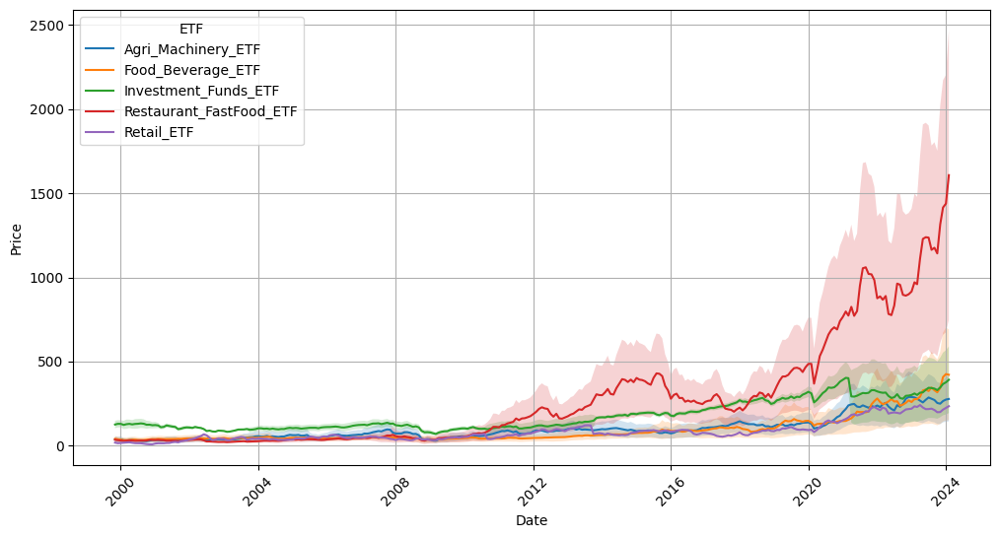

In [15]:

etf_data['Date'] = pd.to_datetime(etf_data[['Year', 'Month']].assign(DAY=1))

etf_data.set_index('Date', inplace=True)

plt.figure(figsize=(12, 6))
sns.lineplot(data=etf_data, x=etf_data.index, y='Price', hue='ETF', markers=False)
for etf in etf_data['ETF'].unique():
    subset = etf_data[etf_data['ETF'] == etf]
    plt.fill_between(subset.index, subset['Price'] - subset['Volatility'], subset['Price'] + subset['Volatility'], alpha=0.2)

# plt.title('Monthly ETF Prices Over Time with Volatility')
plt.xlabel('Date')
plt.ylabel('Price')
plt.xticks(rotation=45)
plt.grid(True)
plt.show()

In [3]:
etfs = etf_data['ETF'].unique()

transformed_etf_data = pd.DataFrame() 

for etf in etfs: 
    tempData = etf_data[etf_data['ETF'] == etf].reset_index()
    transformed_etf_data['Year'] = tempData['Year']
    transformed_etf_data['Month'] = tempData['Month']
    transformed_etf_data[etf + '_Price'] = tempData['Price']
    transformed_etf_data[etf + '_Volatility'] = tempData['Volatility']
    transformed_etf_data = transformed_etf_data.reset_index(drop=True)

In [4]:
transformed_etf_data

,Year,Month,Agri_Machinery_ETF_Price,Agri_Machinery_ETF_Volatility,Food_Beverage_ETF_Price,Food_Beverage_ETF_Volatility,Investment_Funds_ETF_Price,Investment_Funds_ETF_Volatility,Restaurant_FastFood_ETF_Price,Restaurant_FastFood_ETF_Volatility,Retail_ETF_Price,Retail_ETF_Volatility
0,1999,11,36.835142,18.702643,40.019708,16.961994,125.522357,22.170051,34.920701,12.464929,17.868213,0.0
1,1999,12,34.957983,17.379747,37.129539,15.700905,129.629927,21.397963,32.392583,11.780527,14.447012,0.0
2,2000,1,37.142867,18.329527,35.526435,14.800639,129.359423,20.731690,30.139771,9.594676,15.766343,0.0
3,2000,2,31.221460,14.267052,32.619976,14.833653,123.136288,24.351636,28.223431,8.796923,16.672860,0.0
4,2000,3,29.319403,13.248931,31.920499,16.434221,127.442178,27.730370,29.358011,9.440700,18.823416,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...
287,2023,10,253.592562,124.438942,316.868611,195.721885,329.718627,169.790034,1142.686074,610.321548,198.630677,0.0
288,2023,11,249.251962,121.746948,342.498279,214.060211,345.688258,176.976723,1314.577751,705.197133,199.673985,0.0
289,2023,12,264.998565,126.792201,407.599971,264.730916,366.626038,186.600980,1415.650851,757.003628,214.157736,0.0
290,2024,1,273.865412,131.849517,425.311863,276.258099,376.130457,190.784902,1438.604583,764.559535,224.549750,0.0


In [5]:
state_population_data = pd.read_csv("state_population_data.csv")
state_population_data.head(5)

FileNotFoundError: [Errno 2] No such file or directory: 'state_population_data.csv'

In [ ]:
snap_data = pd.read_csv("snap_data.csv")
snap_data.head()

summary_snap_data = snap_data
for column in summary_snap_data.columns:
    if 'Summary' not in column:
        summary_snap_data = summary_snap_data.drop(column, axis = 1) 

summary_snap_data['Year'] = snap_data['Year']
summary_snap_data['Month'] = snap_data['Month']

In [ ]:
finalDF = pd.merge(
    left=summary_snap_data, 
    right=transformed_etf_data,
    how='left',
    left_on=['Year', 'Month'],
    right_on=['Year', 'Month'])

In [ ]:
finalDF = finalDF.dropna()

In [ ]:
summary_snap_data

,Summary_SNAP All Persons Public Assistance Participation,Summary_SNAP All Persons Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA People,Summary_SNAP All Households Public Assistance Participation,Summary_SNAP All Households Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA Households,Summary_SNAP All Total Actual PA & Non-PA Issuance,Year,Month
0,10033430.0,8694465.0,18727895.0,3725119.0,3432740.0,7157859.0,9.716730e+08,1989,1
1,10028846.0,8571573.0,18600419.0,3750006.0,3411273.0,7161279.0,9.530917e+08,1989,7
2,10633151.0,9165459.0,19798610.0,4005774.0,3678631.0,7684405.0,1.165783e+09,1990,1
3,11069768.0,9222609.0,20292377.0,4168557.0,3748117.0,7916674.0,1.181467e+09,1990,7
4,11758987.0,10207681.0,21966668.0,4454154.0,4163159.0,8617313.0,1.397223e+09,1991,1
...,...,...,...,...,...,...,...,...,...
65,6055037.0,35834120.0,41889157.0,4098594.0,18246095.0,22344689.0,8.386243e+09,2021,7
66,6249559.0,35086361.0,41335920.0,4189968.0,17468153.0,21658121.0,8.647230e+09,2022,1
67,6685176.0,34457181.0,41142357.0,4456880.0,17169812.0,21626692.0,9.014863e+09,2022,7
68,6421830.0,36282201.0,42704031.0,4324757.0,18199449.0,22524206.0,9.583957e+09,2023,1


In [ ]:
relative_etf_data = pd.read_csv('relative_etf_performance.csv')
relative_etf_data[['Year', 'Month']] = relative_etf_data['Date'].str.split("-", expand = True)[[0, 1]]
relative_etf_data['Year'] = relative_etf_data['Year'].astype(int)
relative_etf_data['Month'] = relative_etf_data['Month'].astype(int)
relative_etf_data = relative_etf_data.drop('Date', axis = 1)
relative_etf_data

,Agri_Machinery_ETF,Food_Beverage_ETF,Restaurant_FastFood_ETF,Retail_ETF,Year,Month
0,-1.557309,-2.206914,-2.212332,-5.851046,1999,12
1,0.273289,-3.672914,-4.478692,-3.848100,2000,1
2,8.017218,9.727031,10.089114,3.519274,2000,2
3,-13.340422,-13.232104,-10.415068,3.495222,2000,3
4,-4.039071,-4.667150,-3.468667,3.704729,2000,4
...,...,...,...,...,...,...
286,3.617303,4.252479,19.500157,6.218712,2023,10
287,3.287741,4.309151,20.892080,5.800929,2023,11
288,3.224786,4.781845,20.584632,5.719173,2023,12
289,3.223053,4.822167,20.133178,5.793574,2024,1


# Data Visualization

In [ ]:
finalDF

,Summary_SNAP All Persons Public Assistance Participation,Summary_SNAP All Persons Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA People,Summary_SNAP All Households Public Assistance Participation,Summary_SNAP All Households Non-Public Assistance Participation,Summary_Calc: SNAP Total PA and Non-PA Households,Summary_SNAP All Total Actual PA & Non-PA Issuance,Year,Month,Agri_Machinery_ETF_Price,Agri_Machinery_ETF_Volatility,Food_Beverage_ETF_Price,Food_Beverage_ETF_Volatility,Investment_Funds_ETF_Price,Investment_Funds_ETF_Volatility,Restaurant_FastFood_ETF_Price,Restaurant_FastFood_ETF_Volatility,Retail_ETF_Price,Retail_ETF_Volatility
22,6790358.0,10086569.0,16876927.0,2972694.0,4211833.0,7184527.0,1.223131e+09,2000,1,37.142867,18.329527,35.526435,14.800639,129.359423,20.731690,30.139771,9.594676,15.766343,0.0
23,6923448.0,9970737.0,16894185.0,3076395.0,4170816.0,7247211.0,1.223648e+09,2000,7,30.381872,12.649045,33.547624,16.027062,129.957482,28.567374,29.186199,8.518114,14.420985,0.0
24,7131201.0,10158394.0,17289595.0,3172823.0,4256868.0,7429691.0,1.280612e+09,2001,1,33.760939,15.805916,38.209637,17.512640,122.230382,18.868576,33.100672,9.261870,12.277433,0.0
25,6814222.0,10717831.0,17532053.0,3070288.0,4477870.0,7548158.0,1.324812e+09,2001,7,35.808831,18.656423,39.442263,17.926690,113.328149,11.445651,29.873930,8.913858,20.323822,0.0
26,6599560.0,12306086.0,18905646.0,2974883.0,5138760.0,8113643.0,1.513291e+09,2002,1,36.308684,17.836498,42.942141,19.692925,107.427076,10.605124,34.036774,12.375332,37.061765,0.0
27,6587049.0,12691496.0,19278545.0,3031209.0,5238413.0,8269622.0,1.530643e+09,2002,7,35.104314,14.729091,41.908781,20.341799,86.717126,3.123611,24.500837,2.677727,61.202939,0.0
28,6451602.0,14504205.0,20955807.0,2983687.0,6037777.0,9021464.0,1.714953e+09,2003,1,35.555201,15.528725,45.628324,23.429254,87.025251,3.595464,22.072676,3.992951,40.266331,0.0
29,6501719.0,15518599.0,22020318.0,3052163.0,6399975.0,9452138.0,1.858042e+09,2003,7,42.074329,21.784052,45.532581,22.113362,95.969641,5.557166,25.795741,4.774985,51.766492,0.0
30,6599404.0,16850844.0,23450248.0,3124609.0,6971117.0,10095726.0,1.996372e+09,2004,1,55.729010,29.881298,46.831087,20.877017,102.896777,15.264649,26.259795,9.733167,42.075329,0.0
31,6715770.0,17632189.0,24347959.0,3219005.0,7315745.0,10534750.0,2.110605e+09,2004,7,53.529266,28.214500,42.801399,14.674046,98.274449,18.118304,28.858436,14.080494,37.749301,0.0


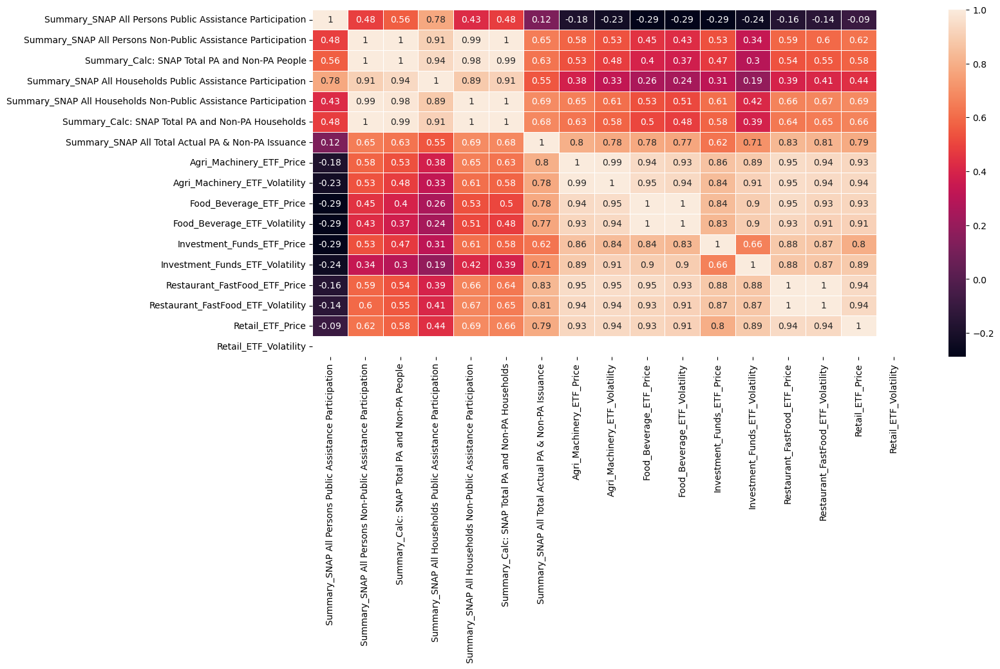

In [ ]:
corr_matrix = finalDF.drop(columns=['Year', 'Month']).corr()

plt.figure(figsize=(15, 7))
sns.heatmap(corr_matrix, annot=True, cmap='rocket', linewidths=0.5)
plt.show()

In [ ]:
states = snap_data.columns[2:].str.split("_")
states = set([state[0] for state in states])

for state in states:
    state_snap_data = snap_data
    for column in state_snap_data.columns:
        if state not in column:
            state_snap_data = state_snap_data.drop(column, axis = 1) 
    
    state_snap_data['Year'] = snap_data['Year']
    state_snap_data['Month'] = snap_data['Month']
    
    finalDF2 = pd.merge(
        left=state_snap_data, 
        right=transformed_etf_data,
        how='left',
        left_on=['Year', 'Month'],
        right_on=['Year', 'Month'])
    
    finalDF2 = finalDF2.dropna()
    
    corr_matrix = finalDF2.drop(columns=['Year', 'Month']).corr()
    
    plt.figure(figsize=(15, 7))
    sns.heatmap(corr_matrix, annot=True, cmap='rocket', linewidths=0.5)
    plt.show()

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


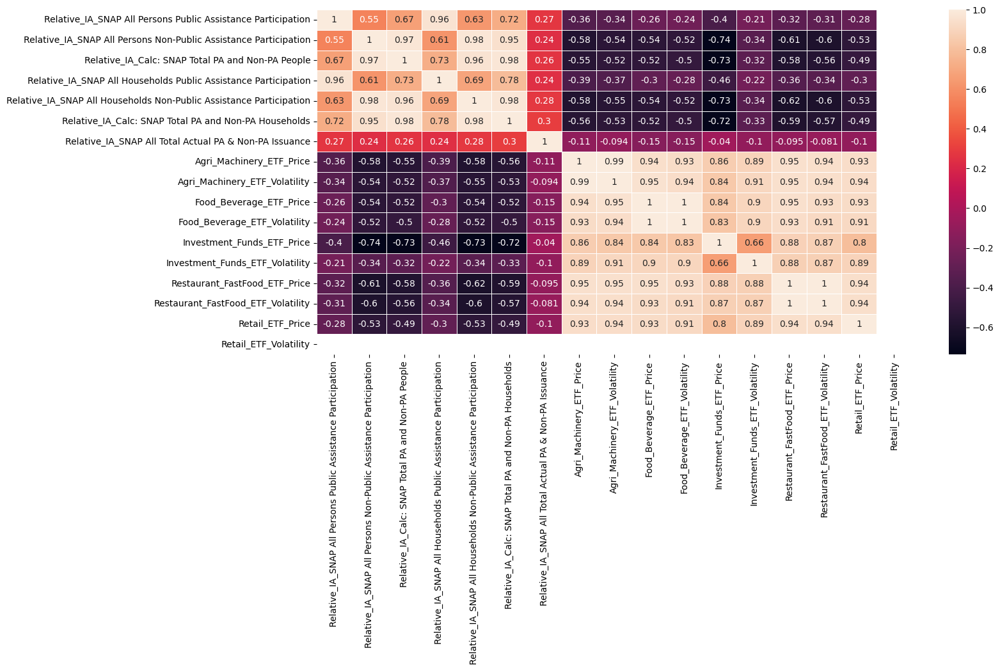

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn9

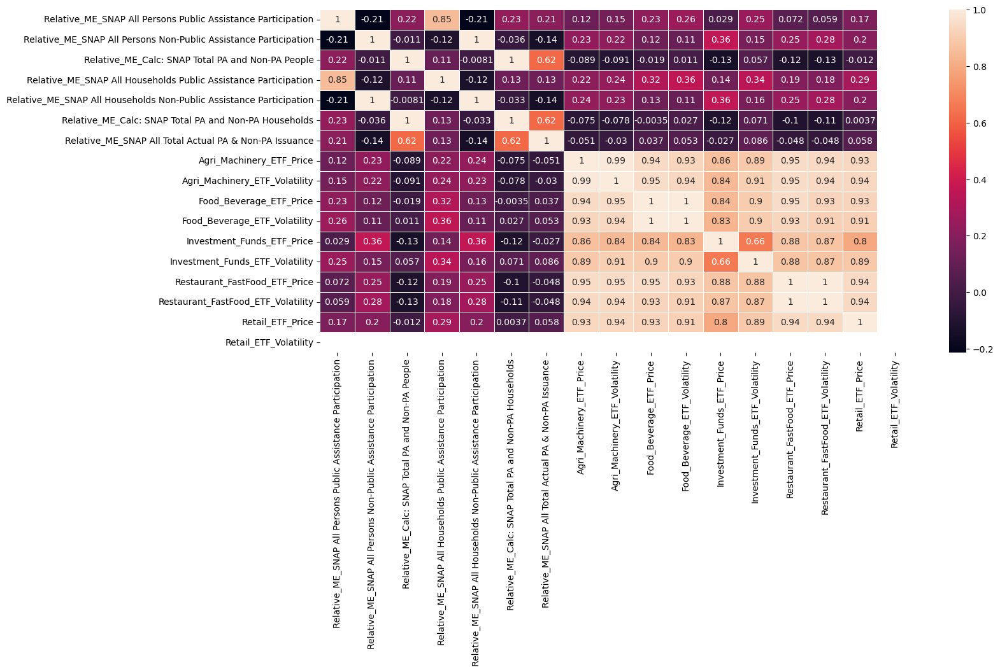

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn9

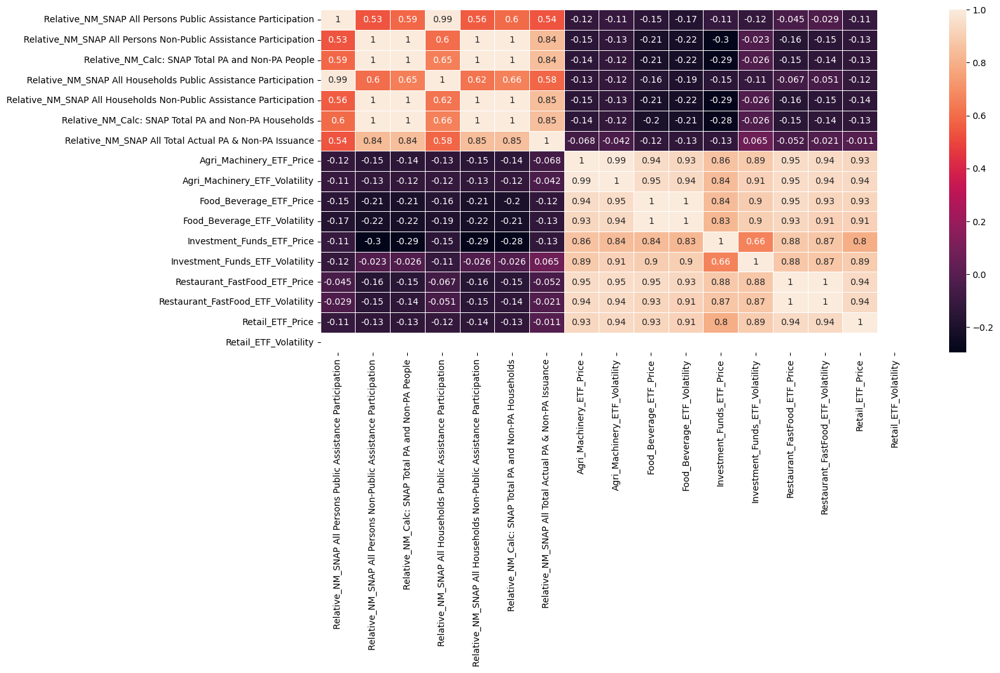

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


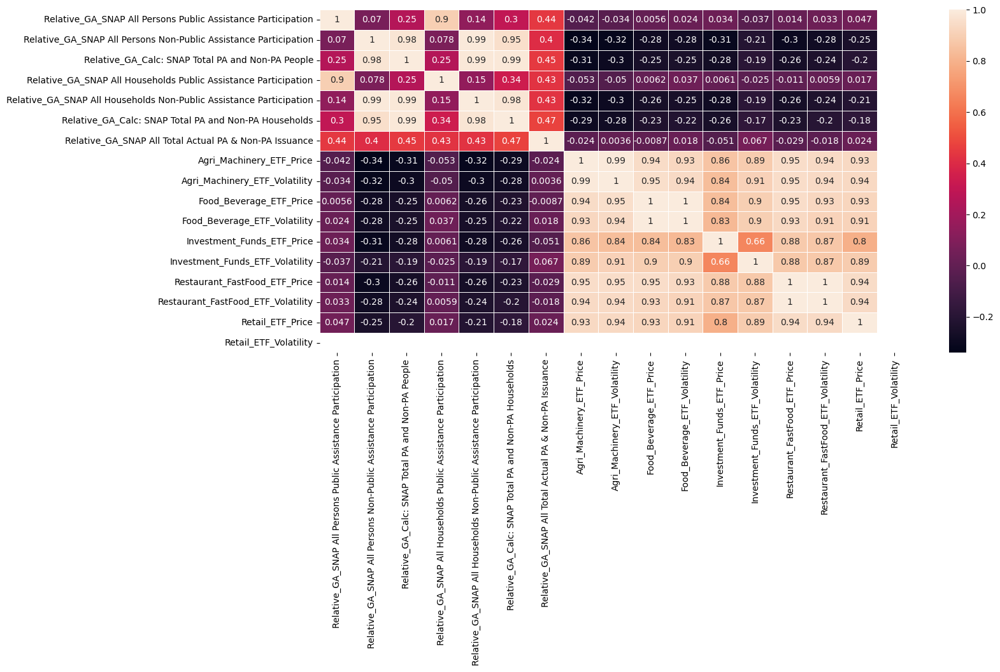

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


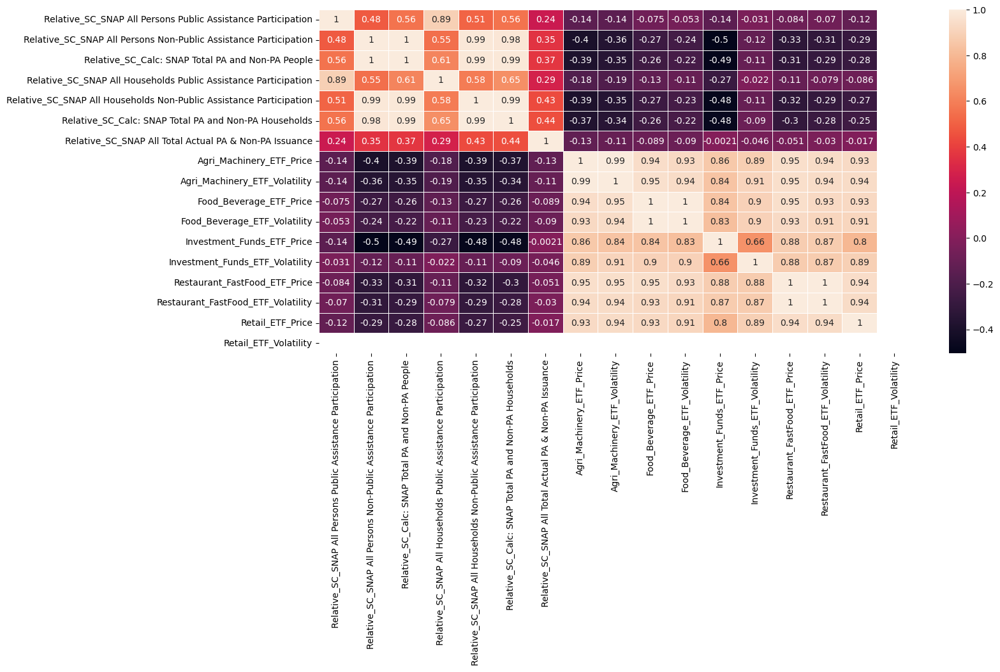

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


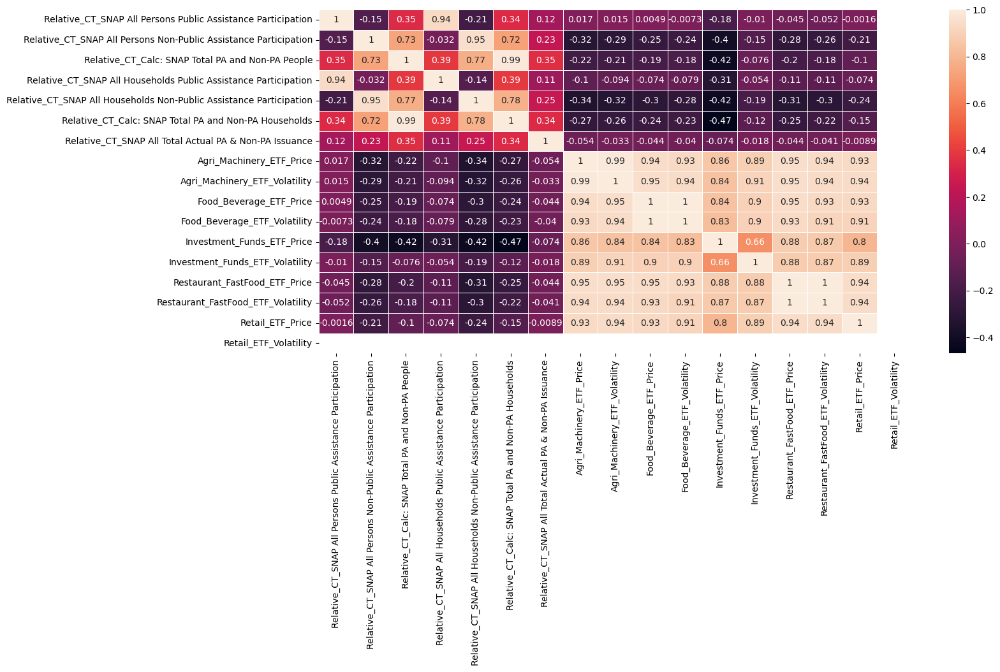

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


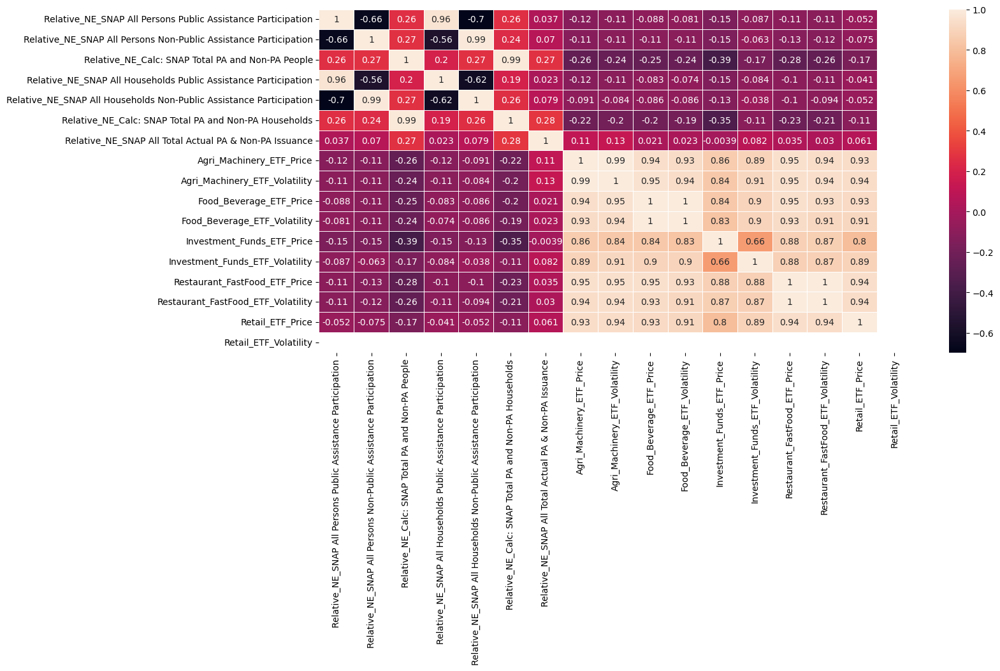

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


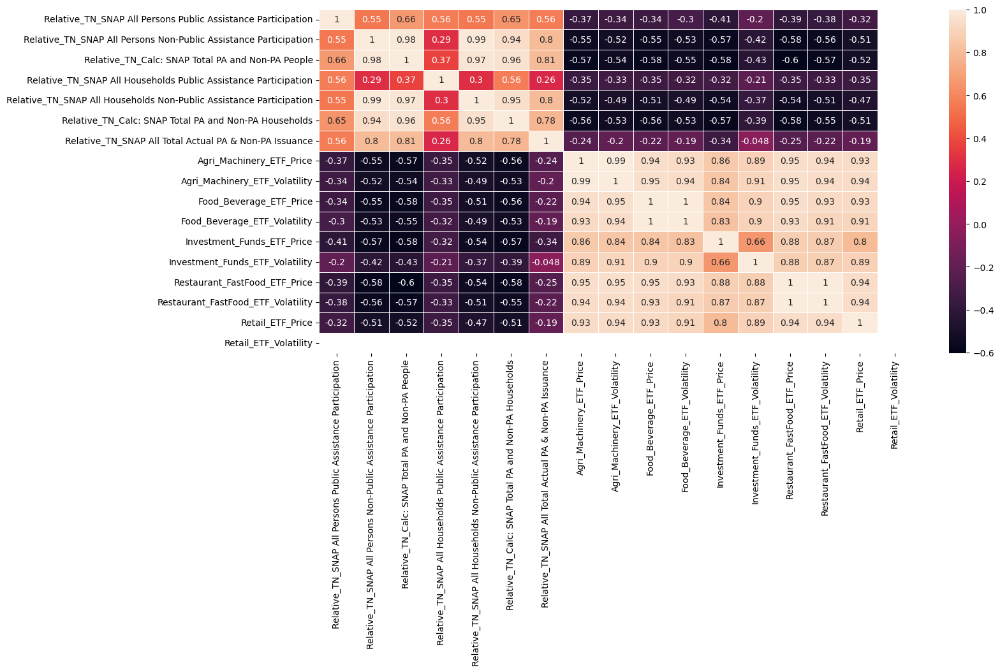

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


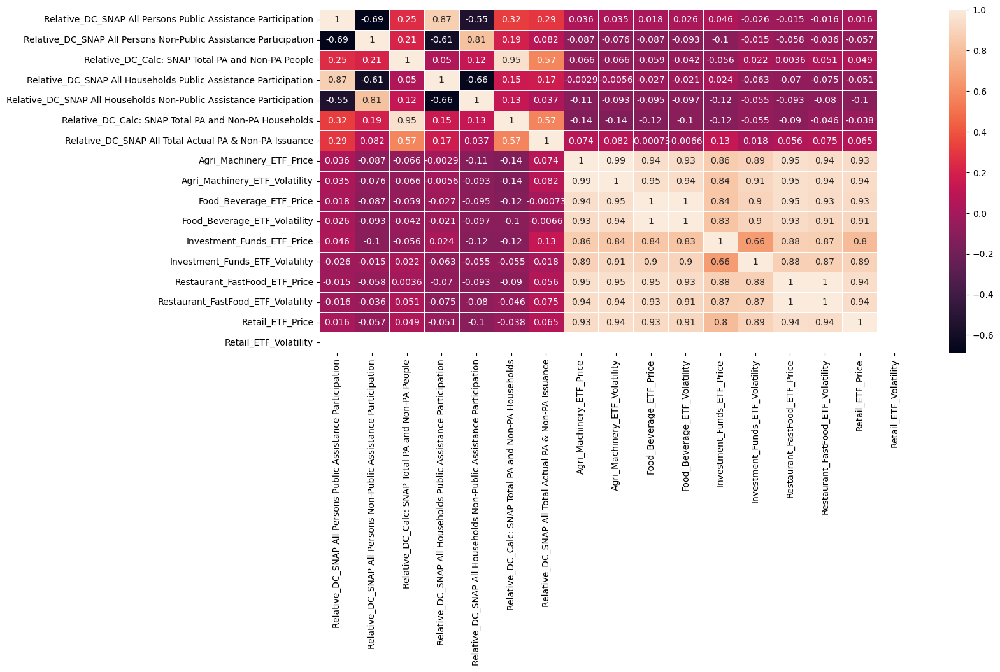

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


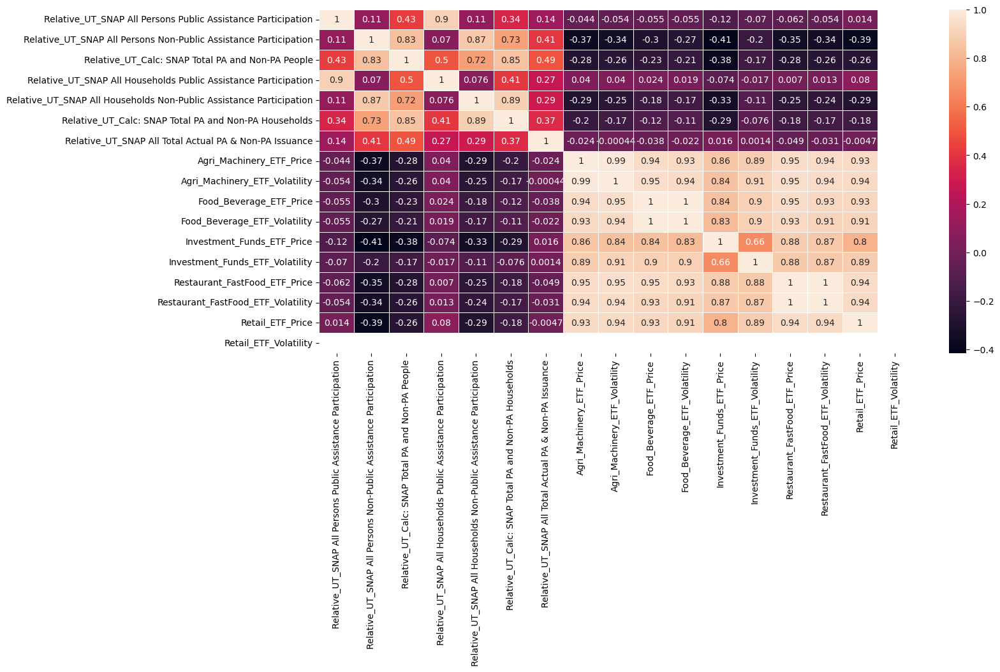

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn9

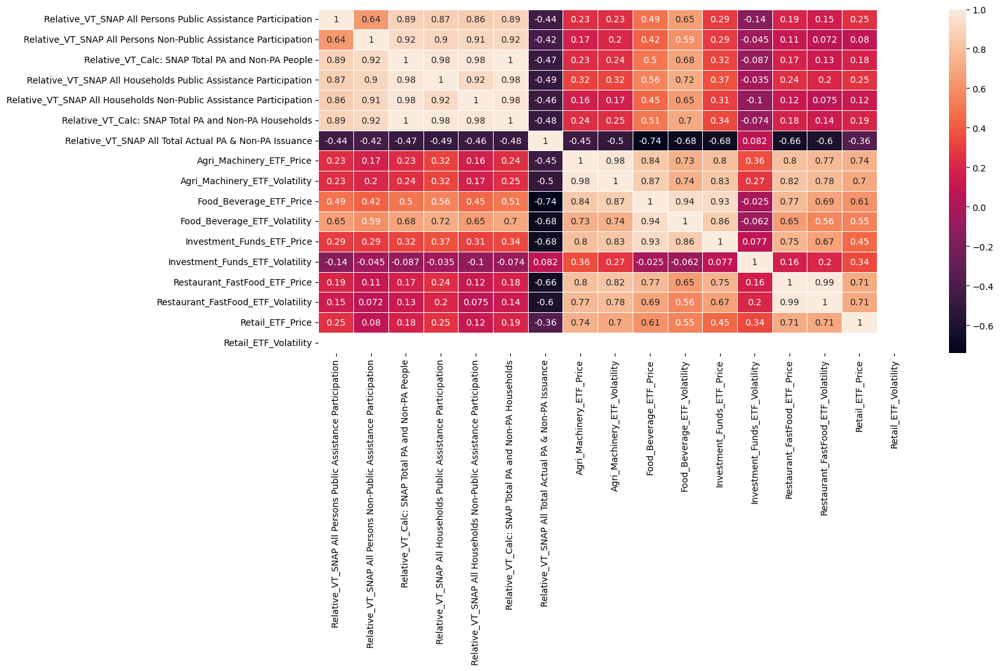

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


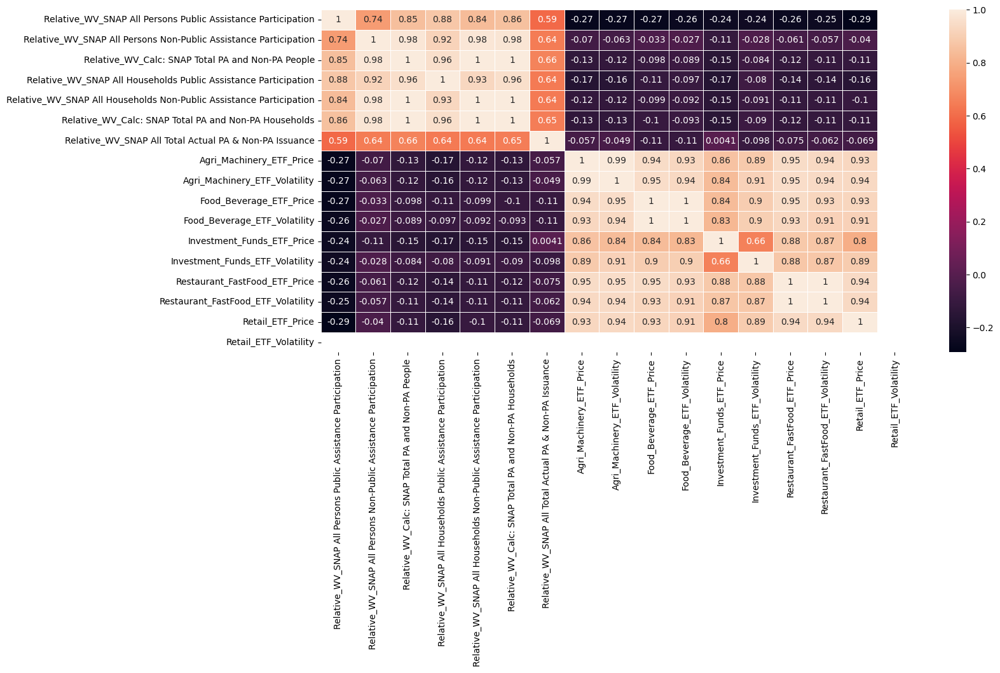

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


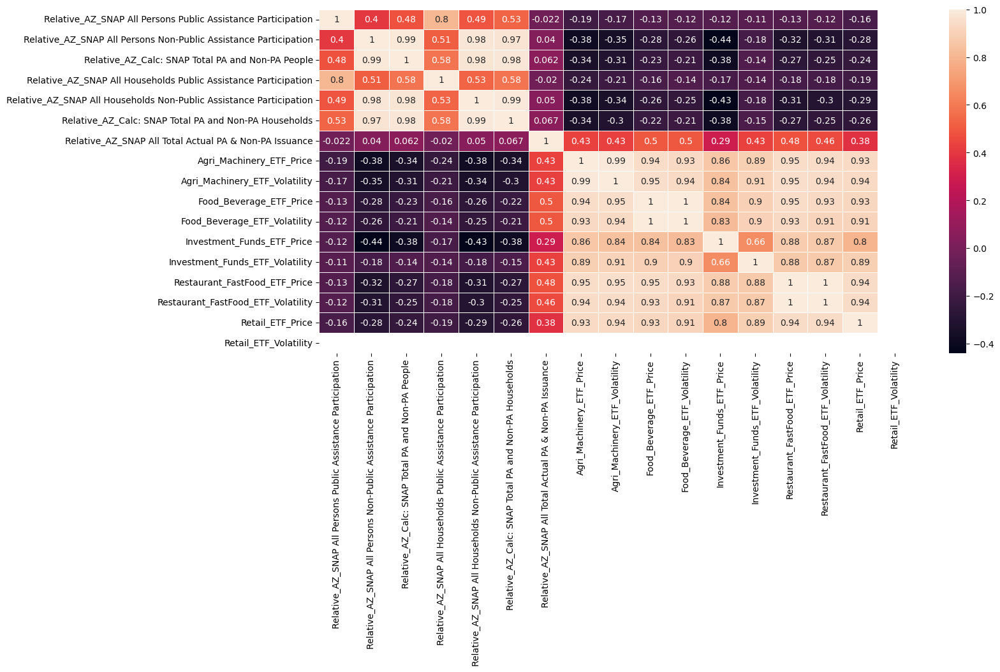

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


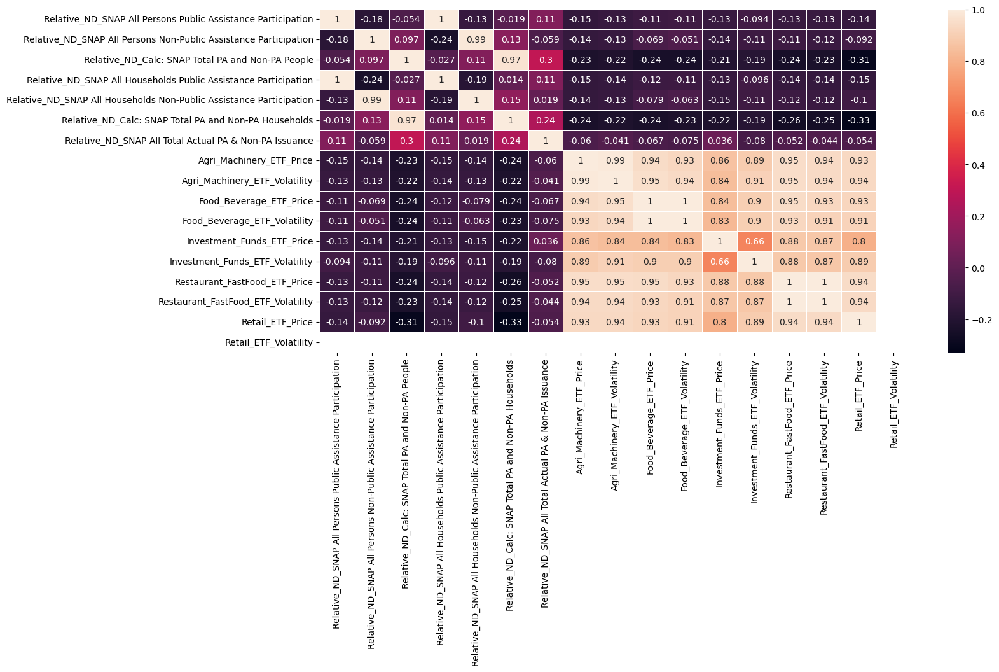

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: invalid value encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92

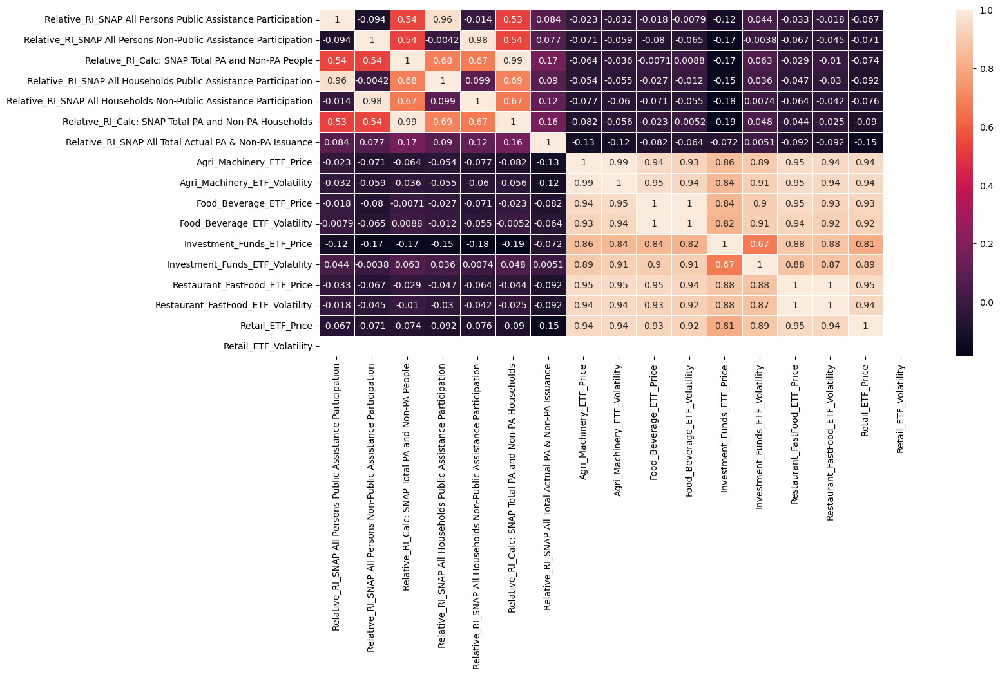

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


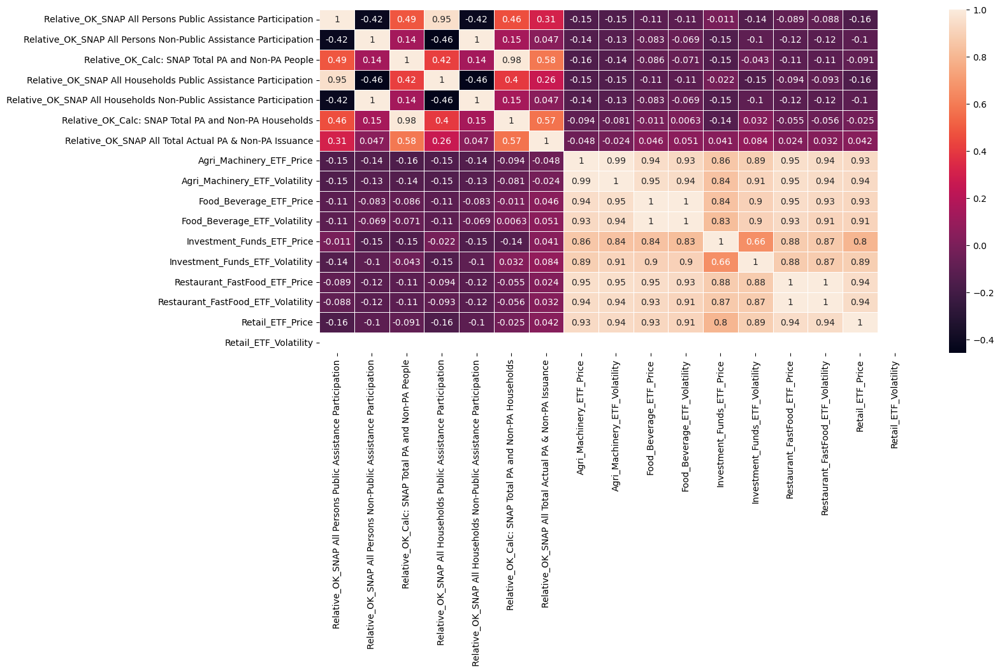

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: invalid value encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100


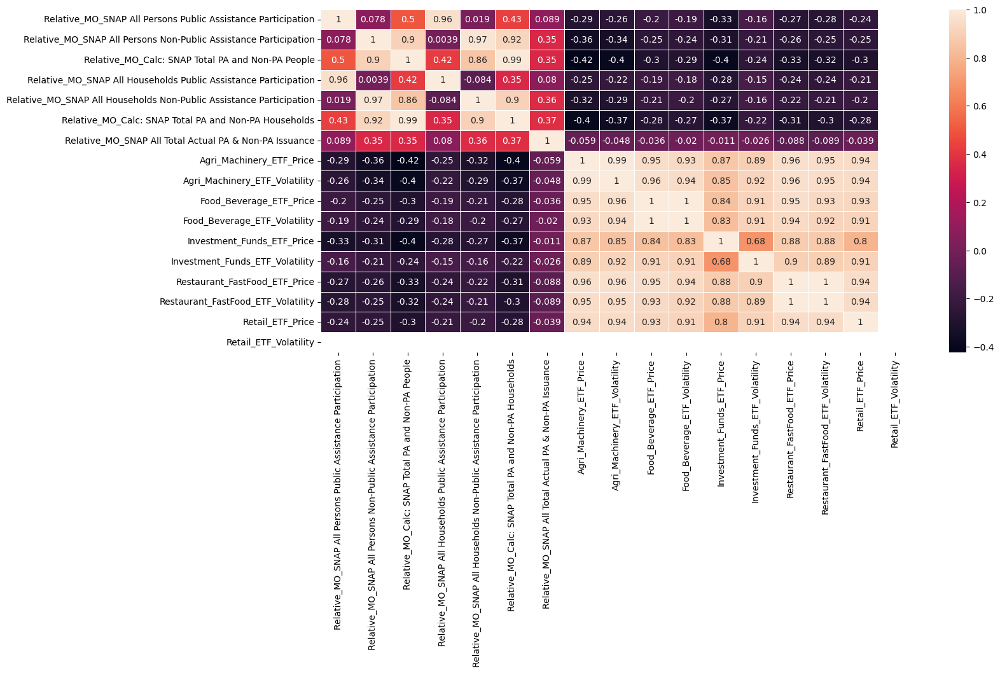

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


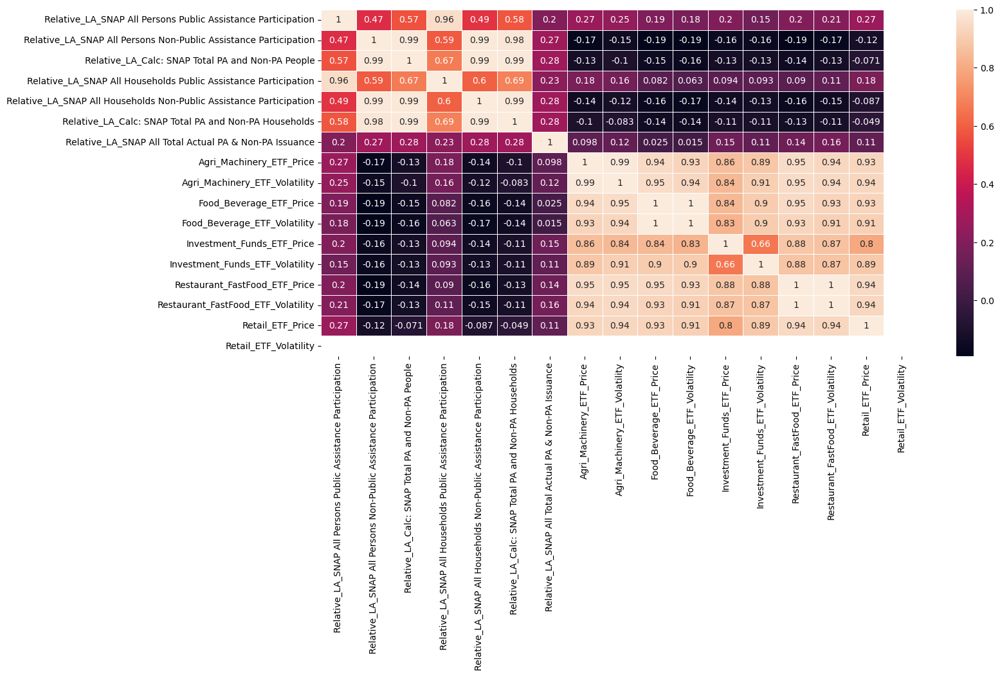

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


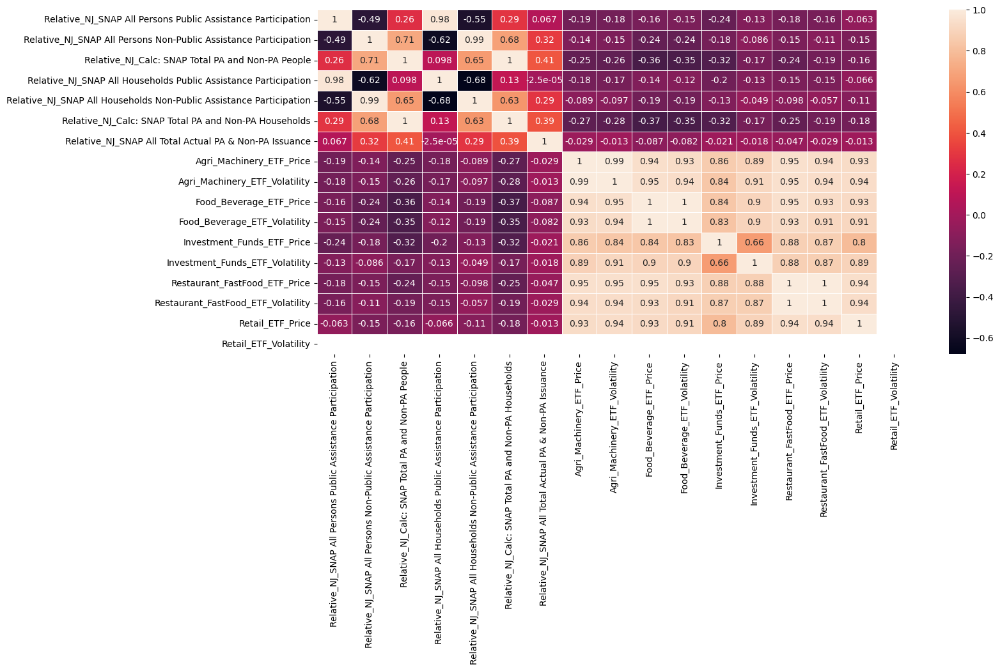

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


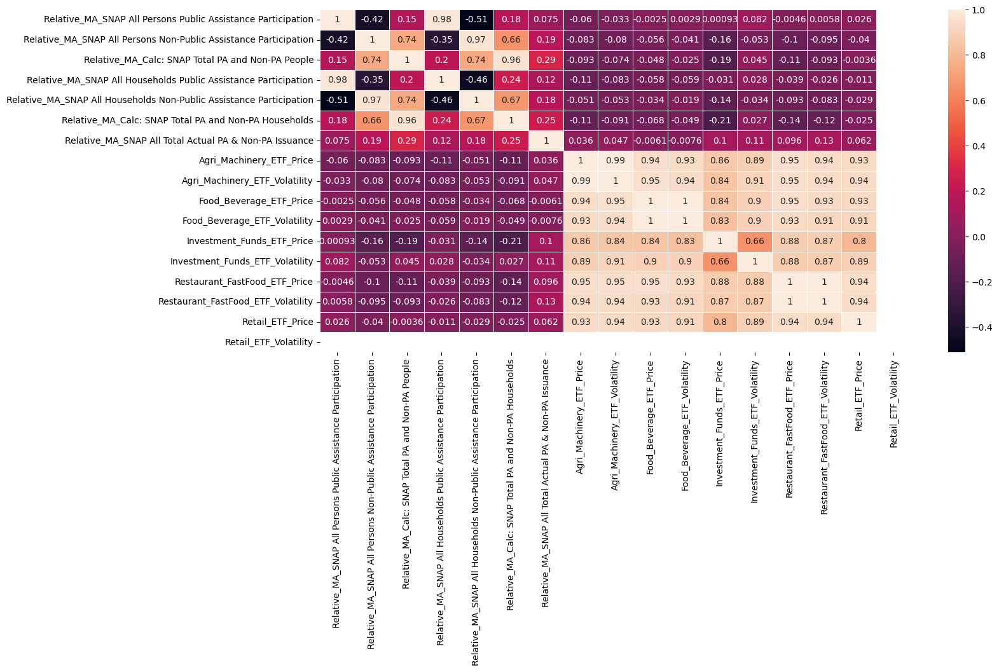

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


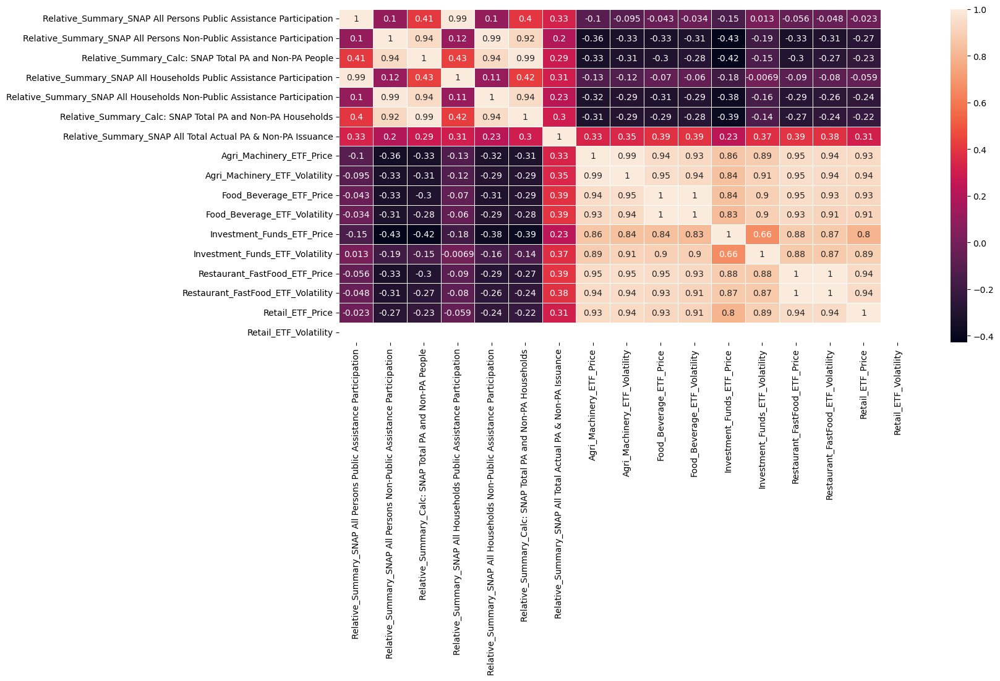

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


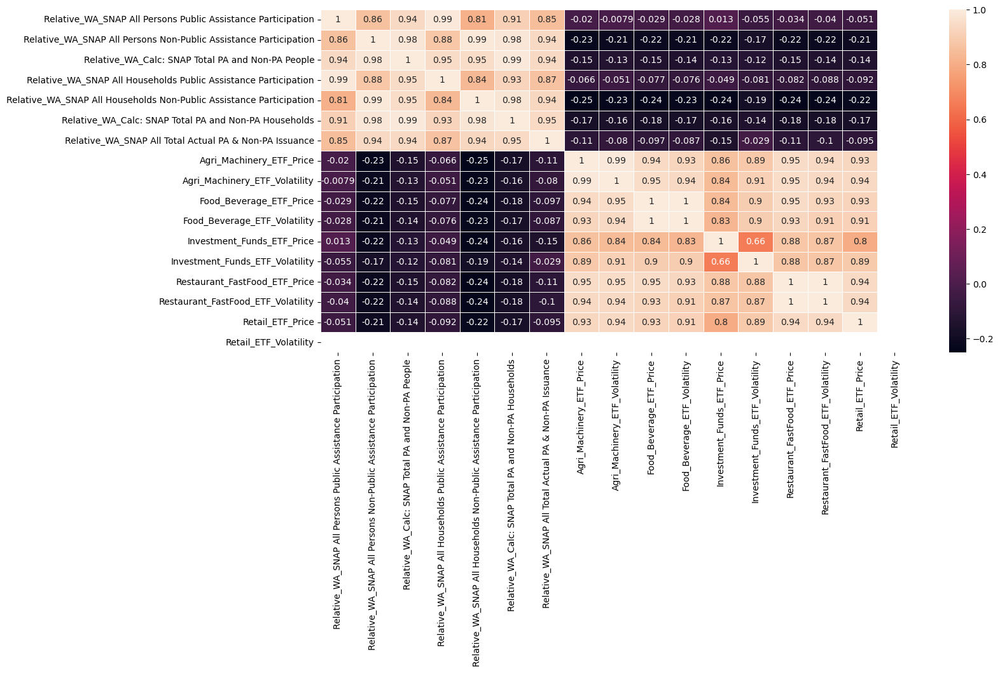

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: invalid value encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92

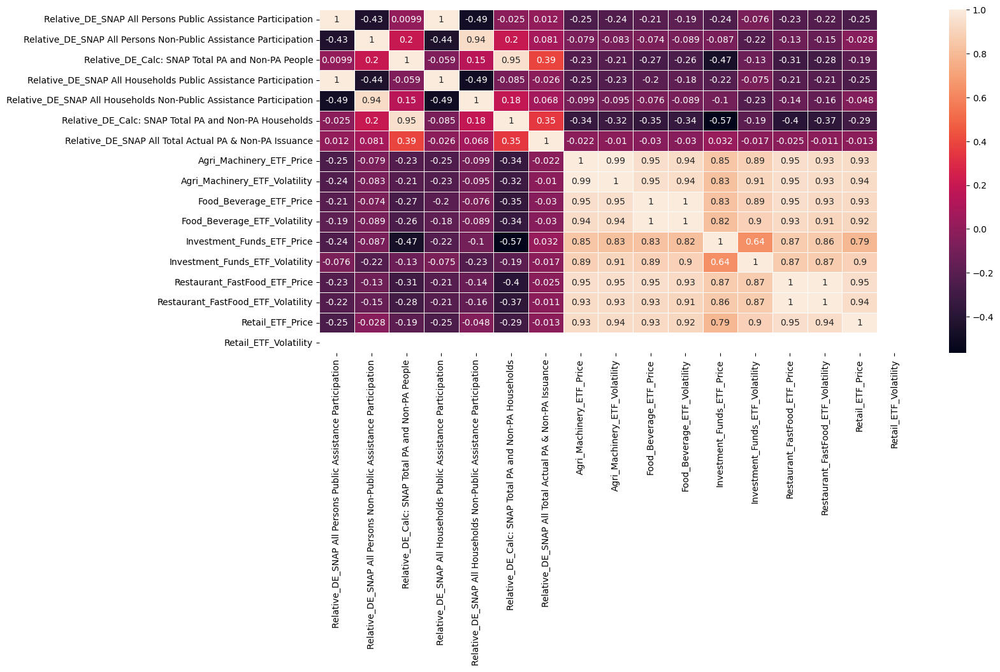

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


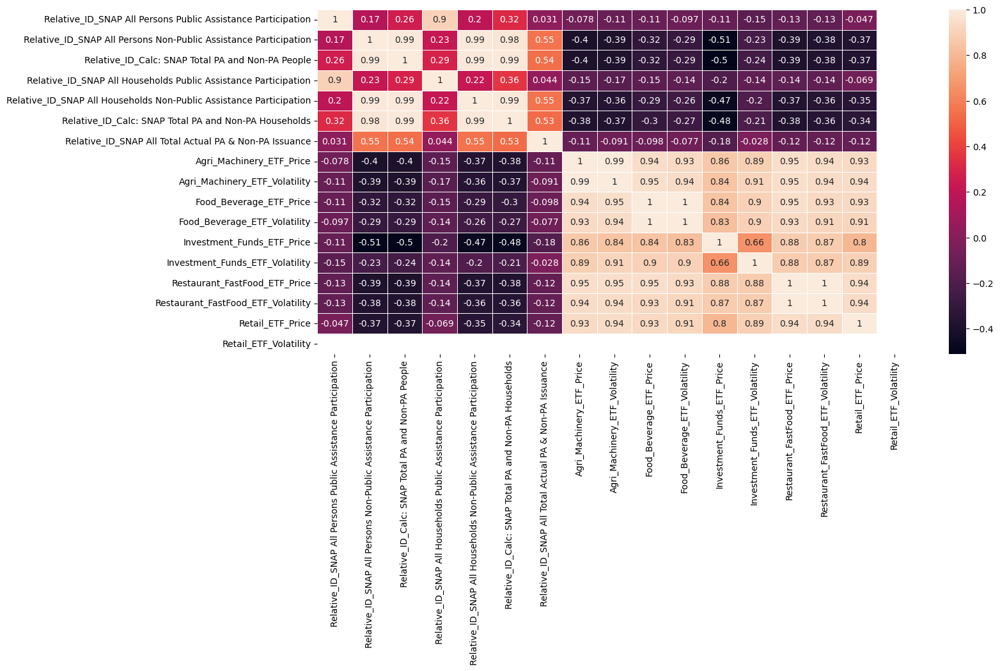

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn9

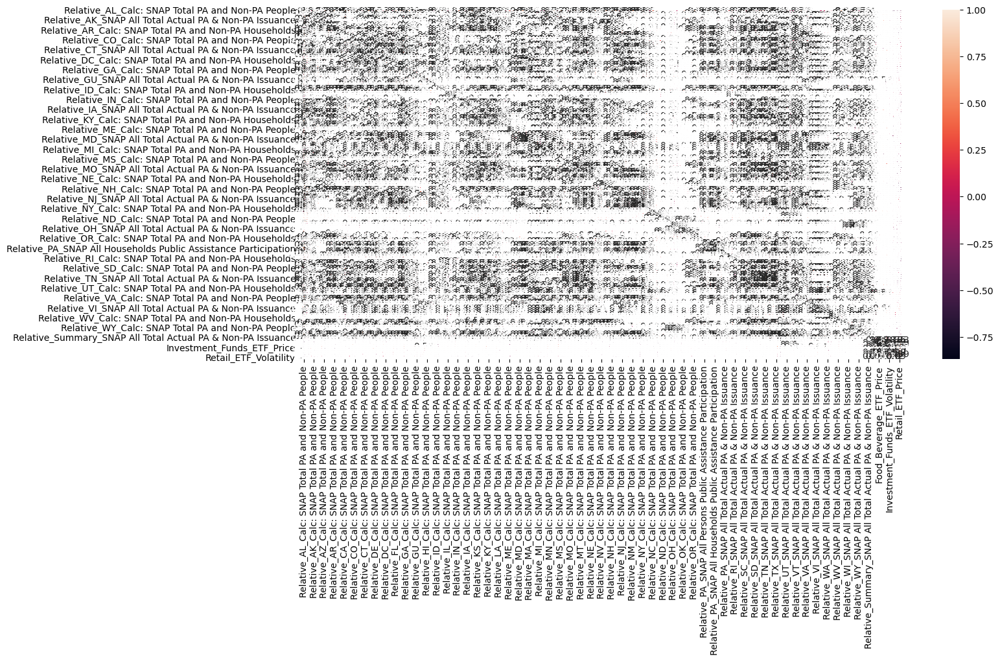

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


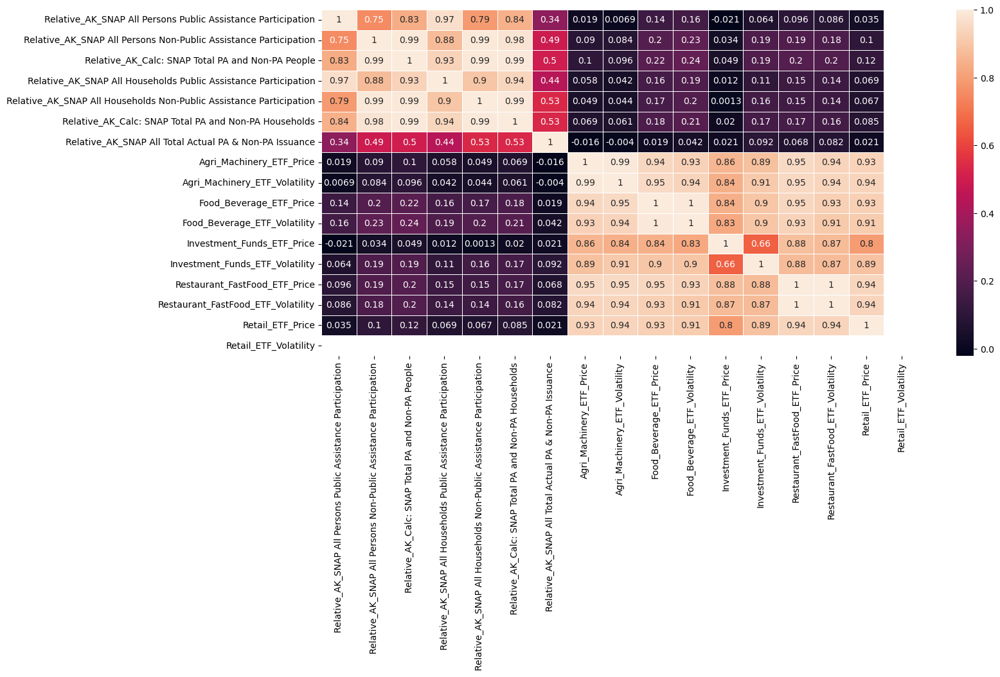

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


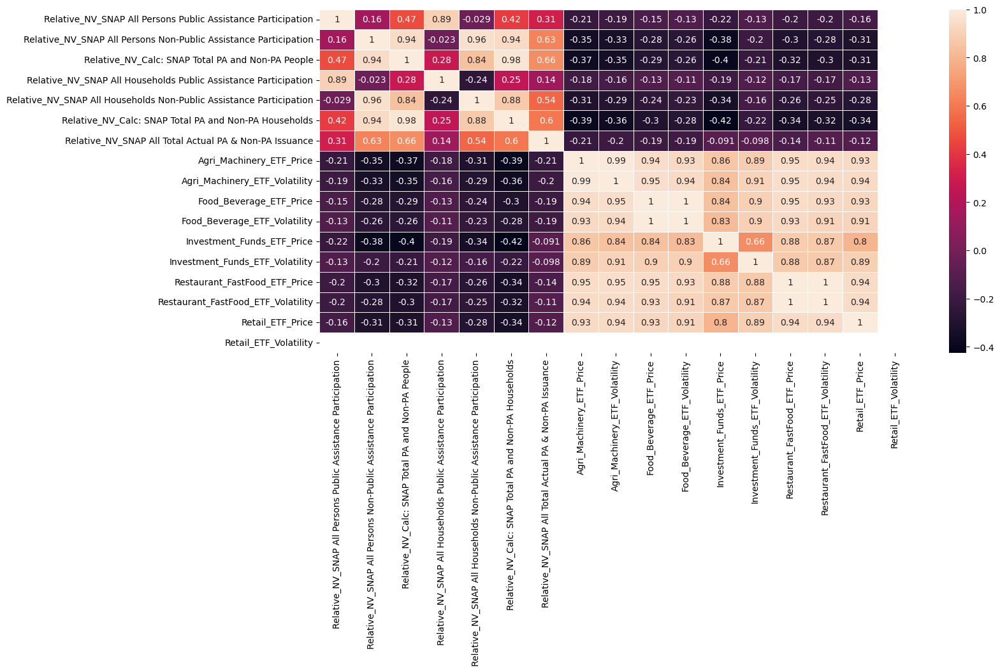

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


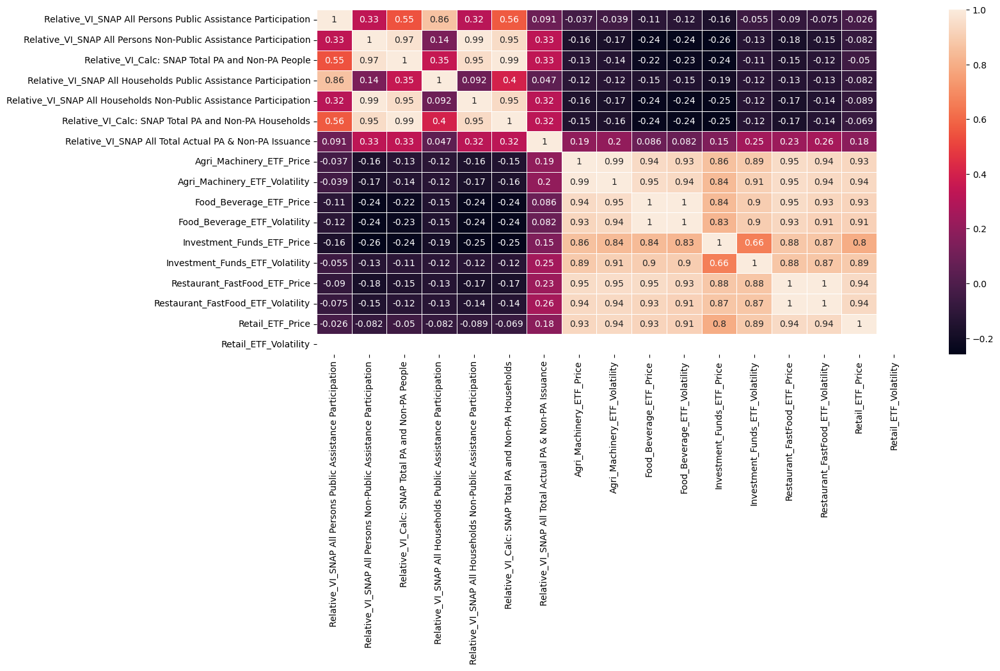

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


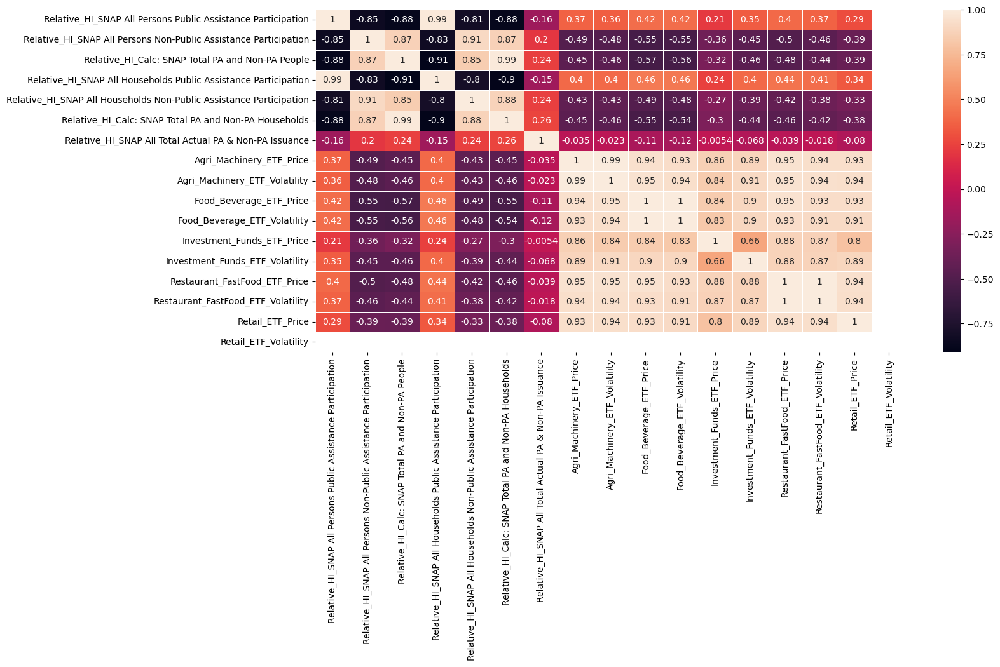

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: invalid value encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92

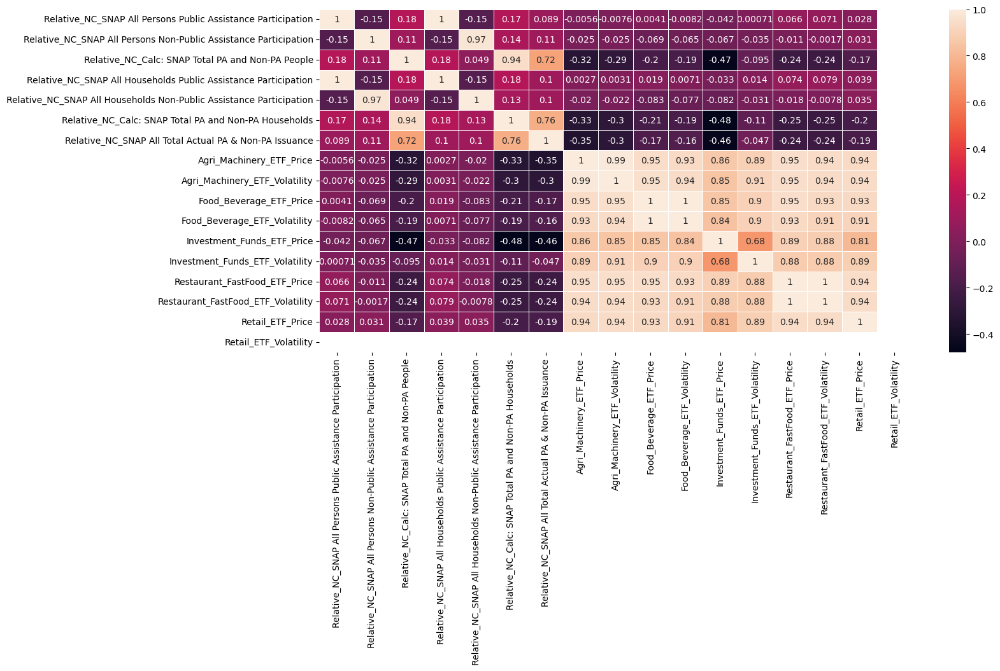

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


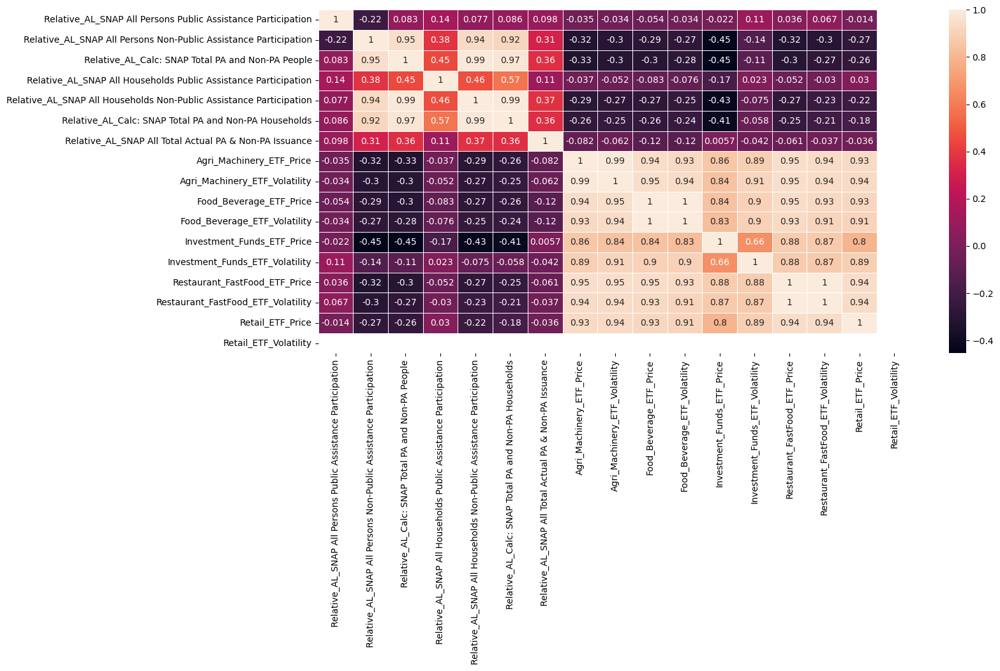

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal
/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:19: RuntimeWarning: divide by zero encountered in divide
  tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
/var/folders/_x/3gwpfcn9

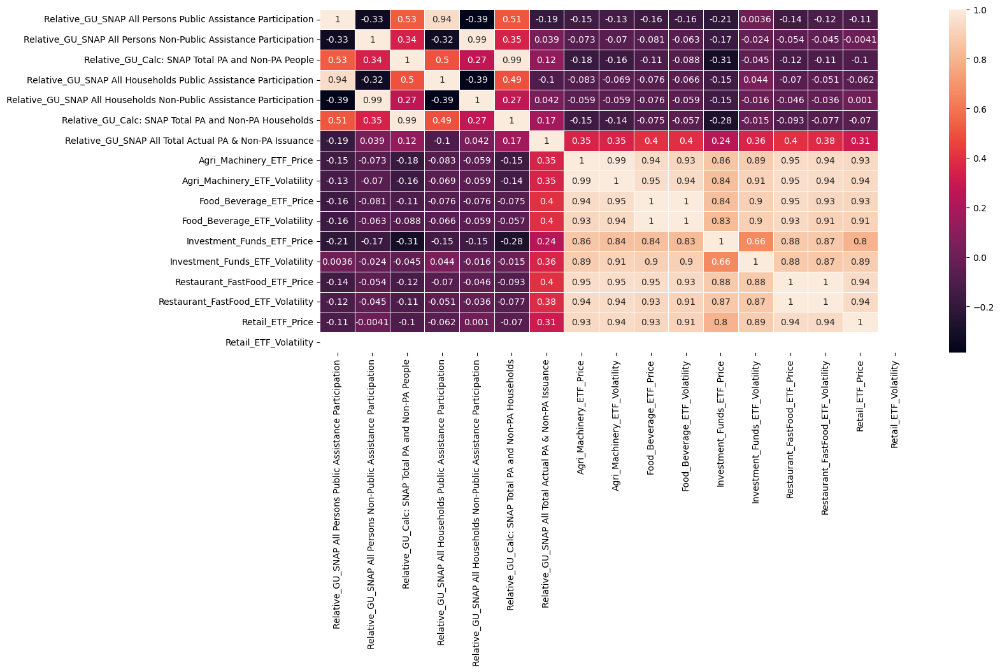

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


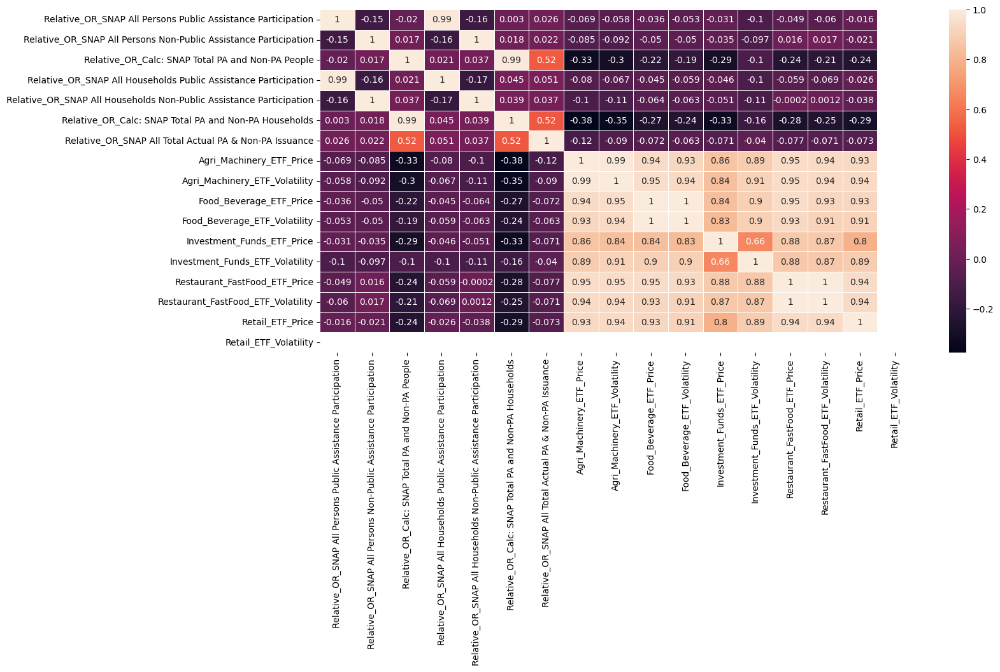

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


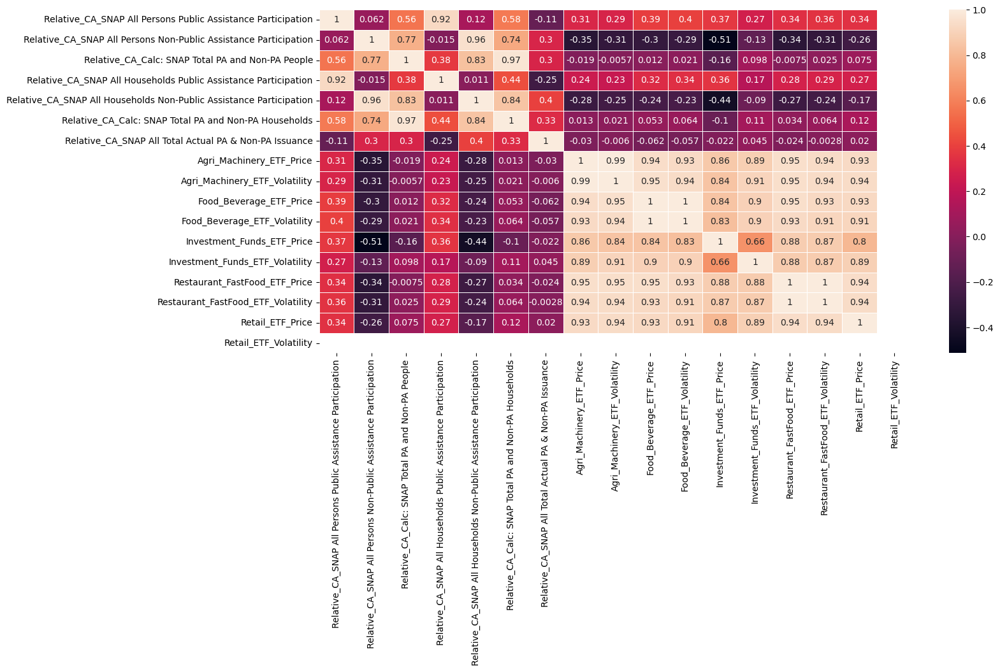

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


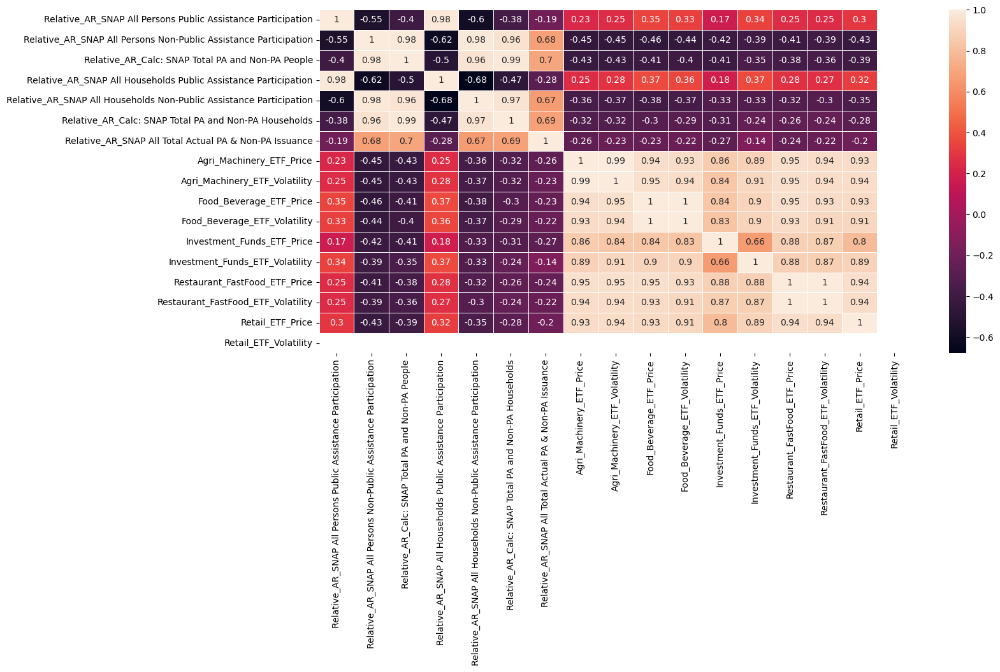

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


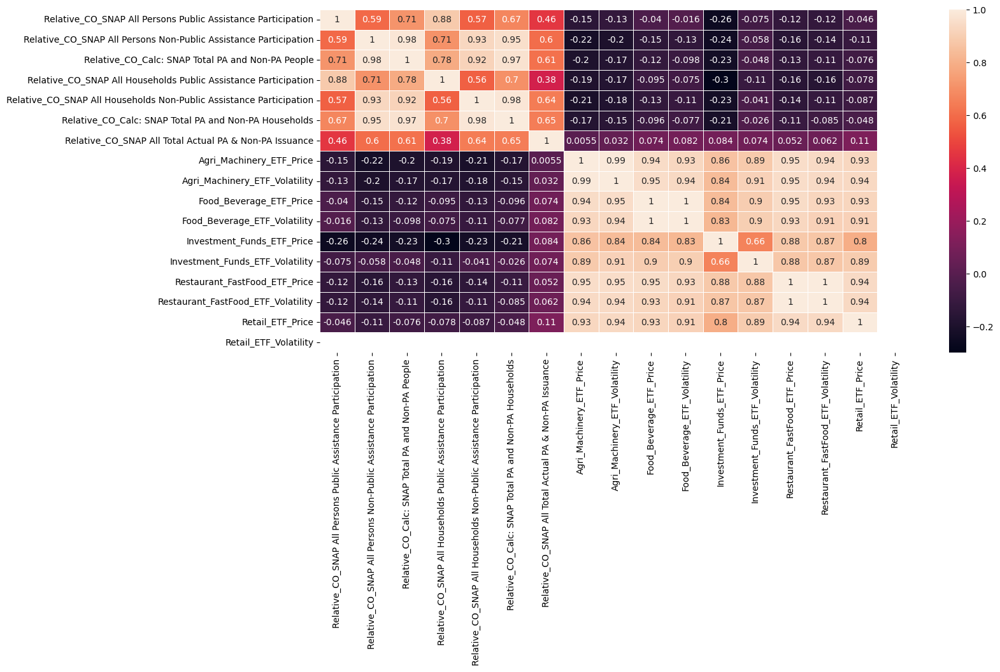

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


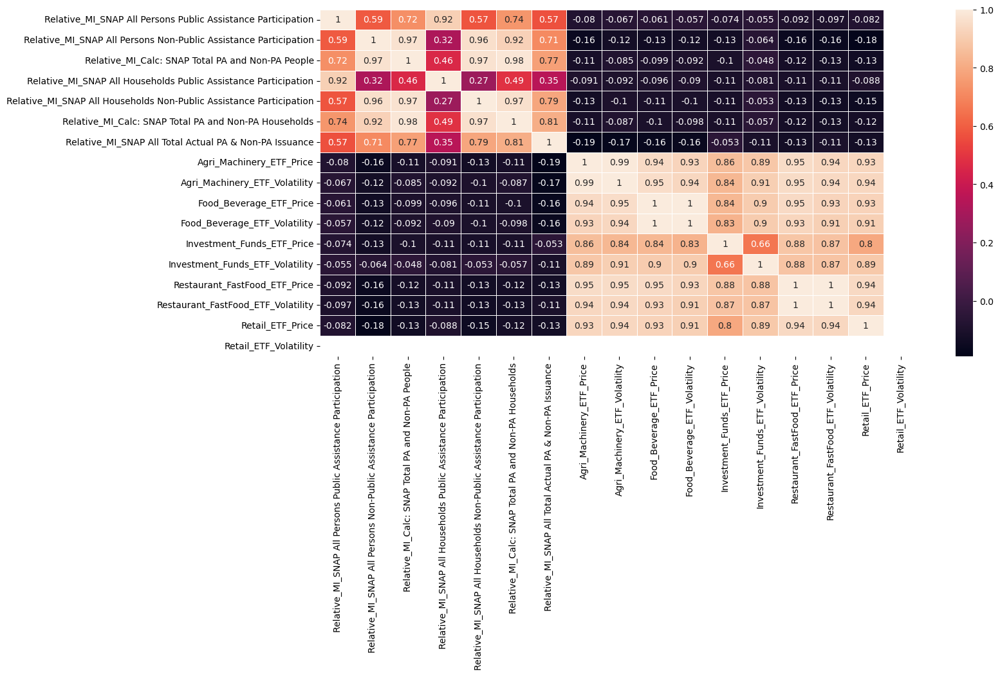

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


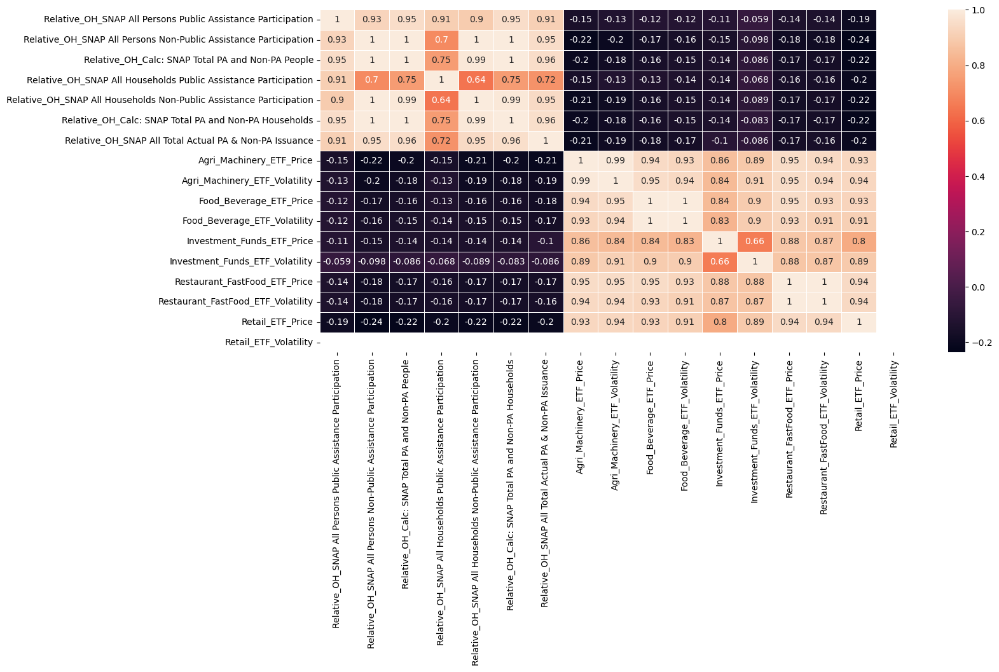

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


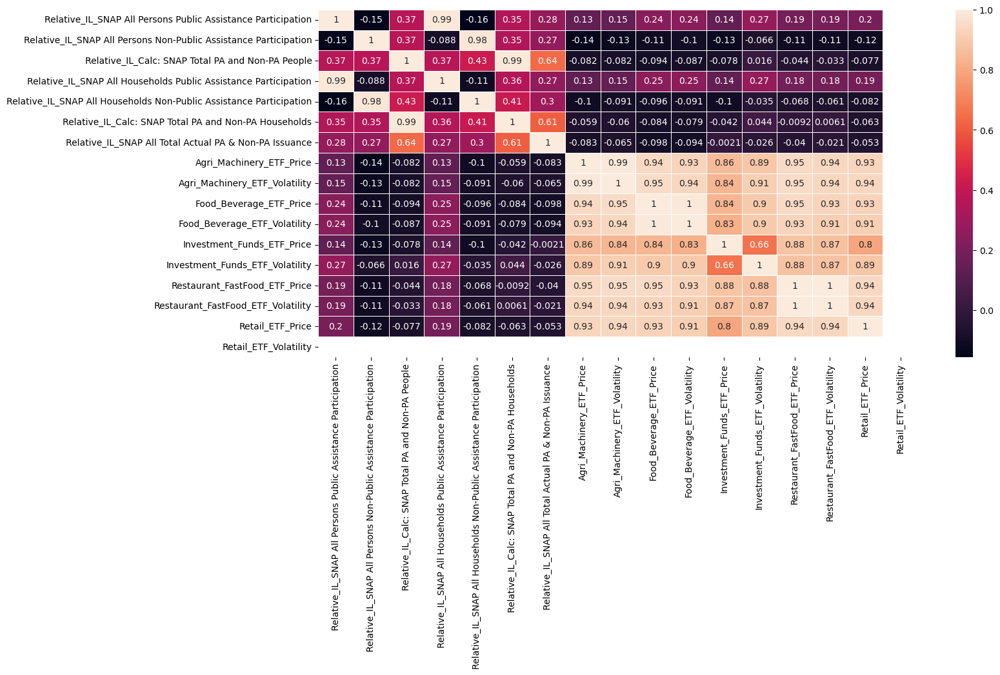

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


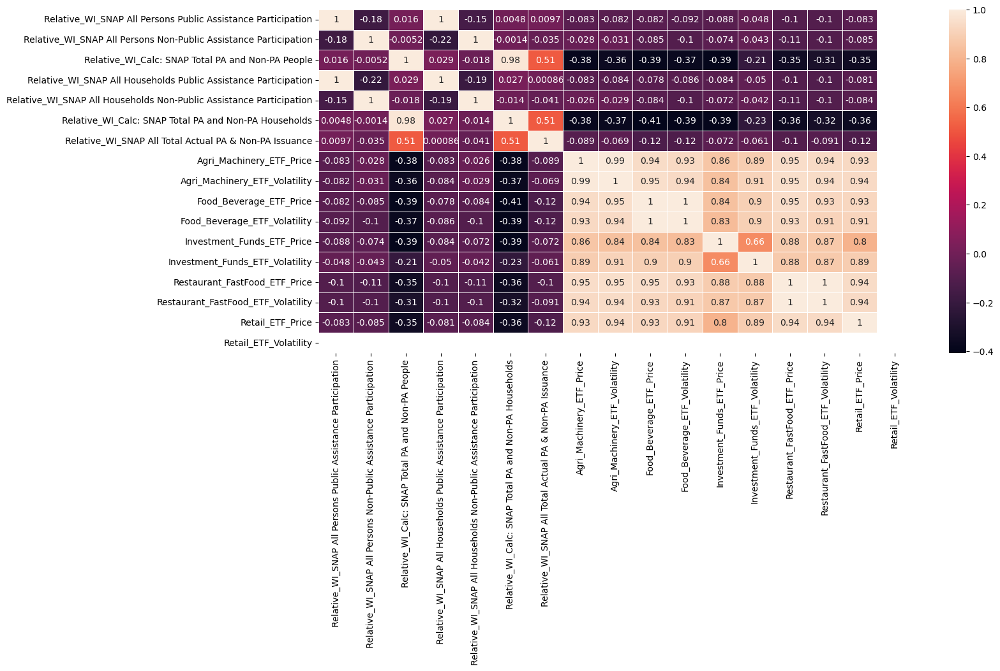

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


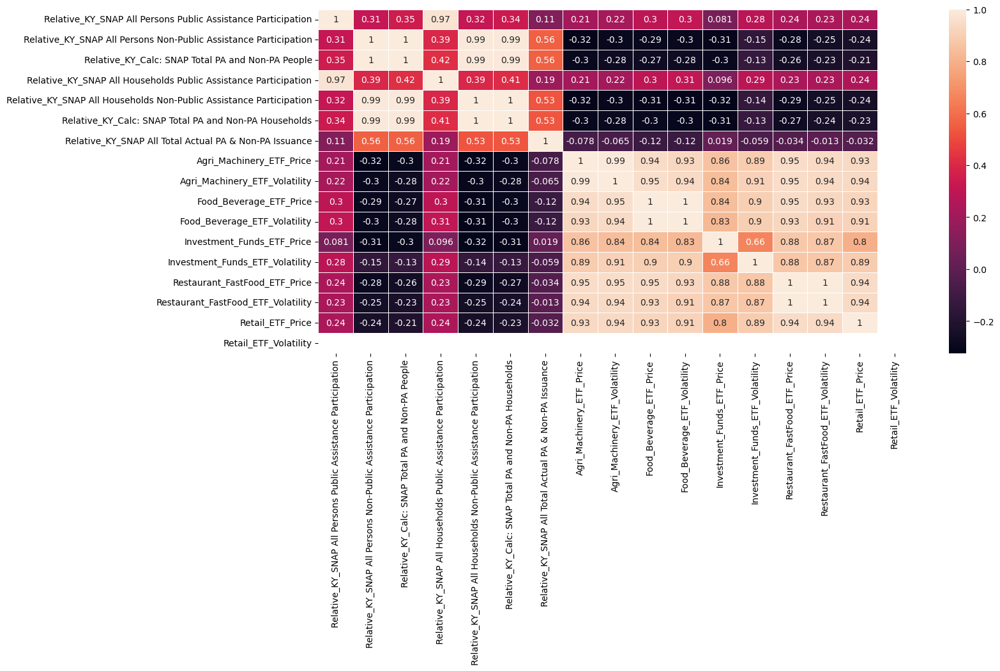

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


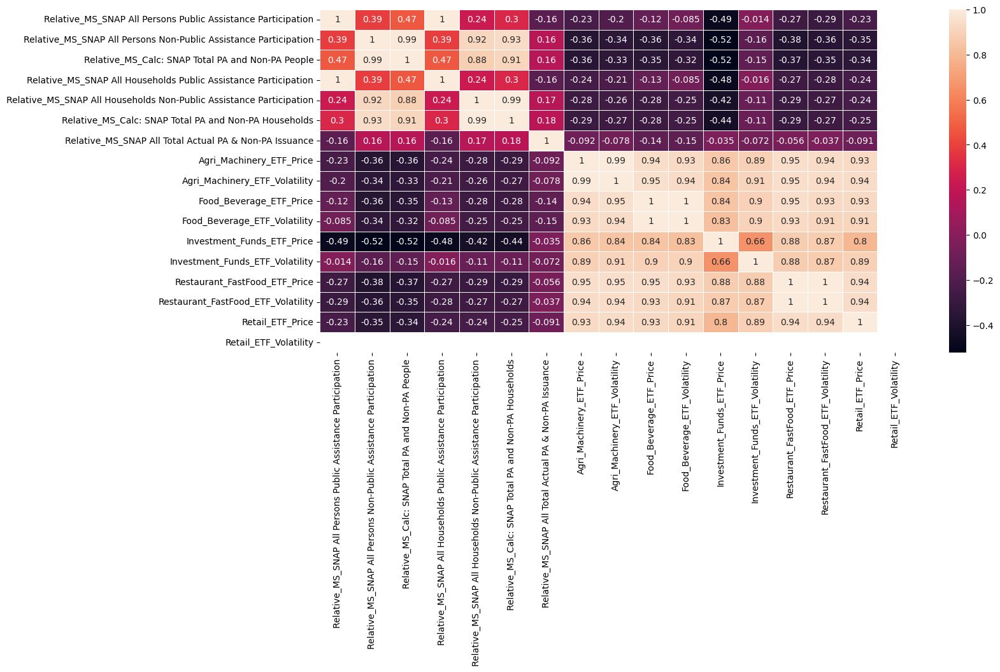

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


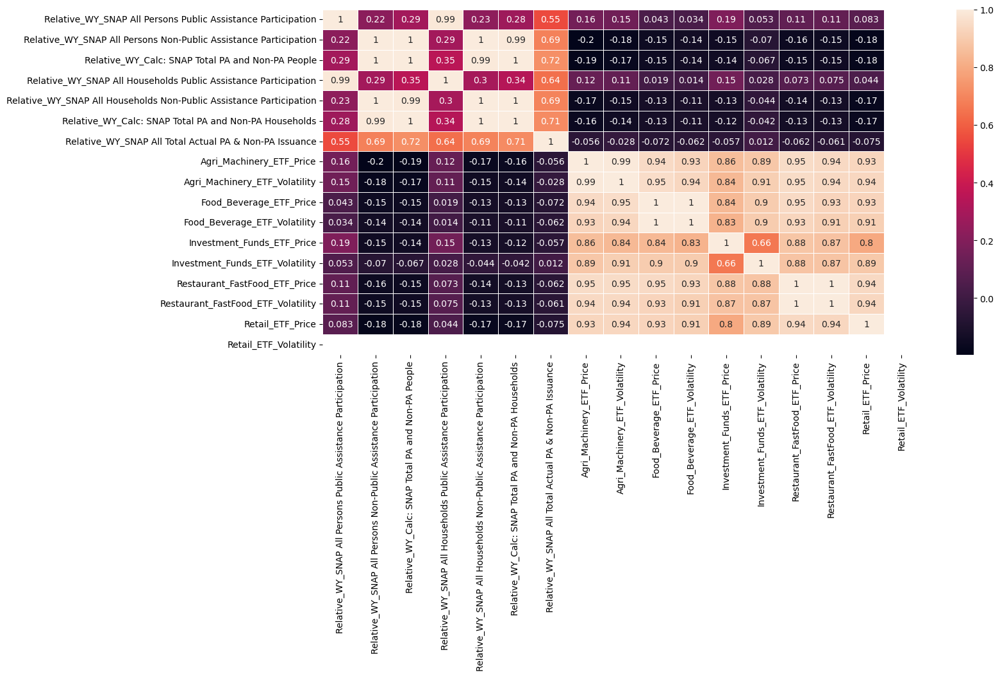

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


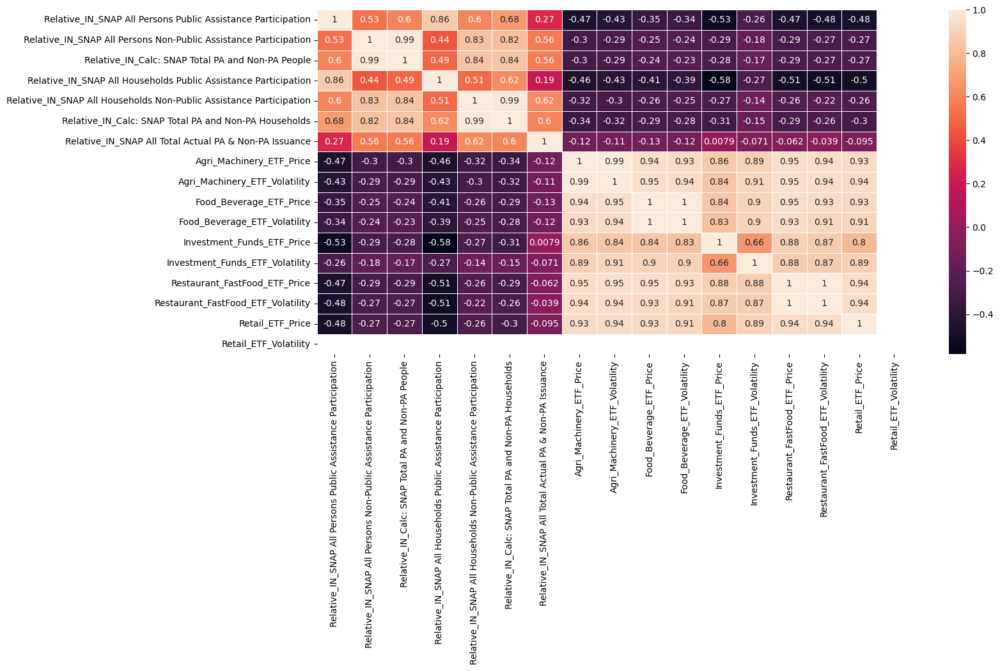

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


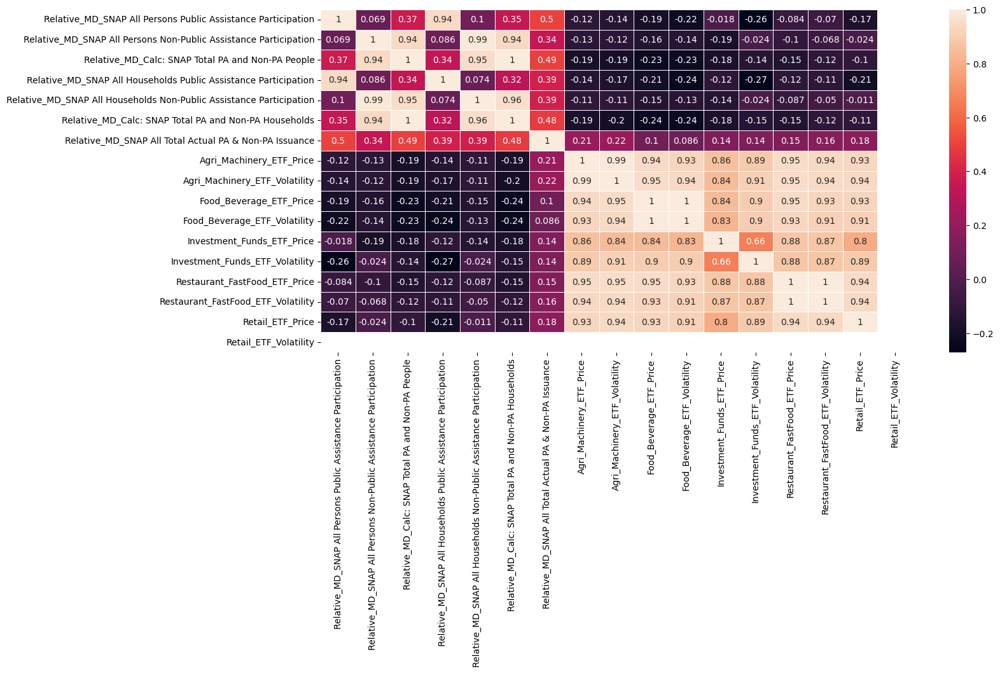

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


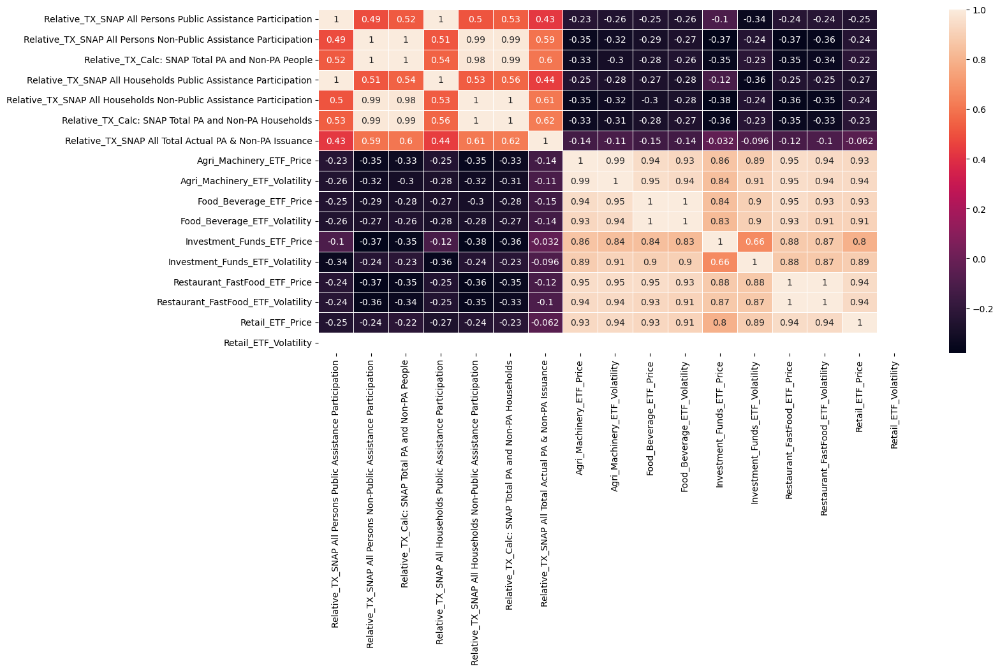

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


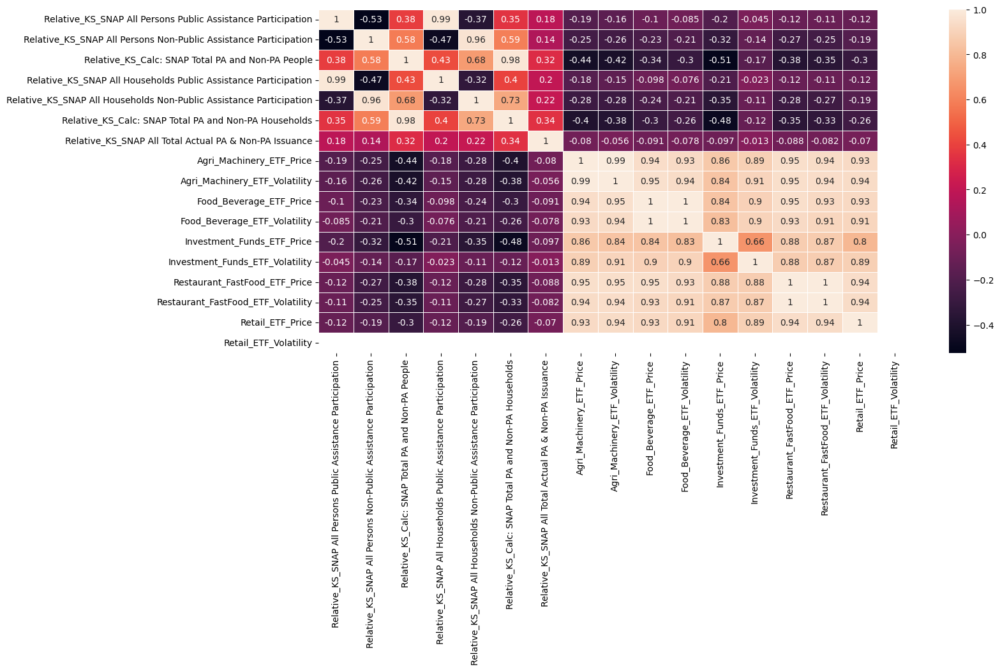

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


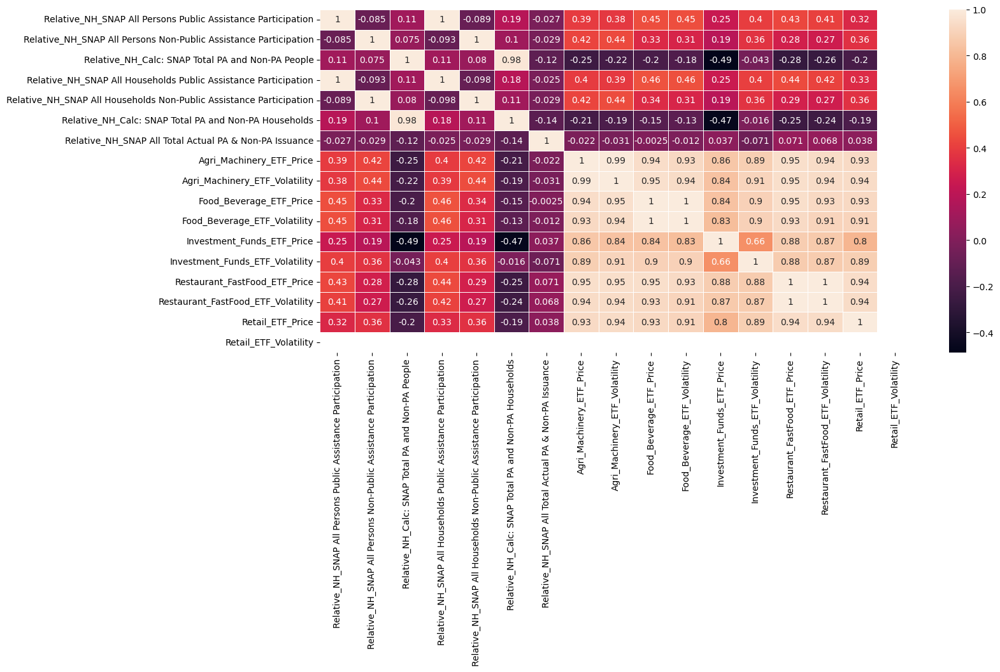

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


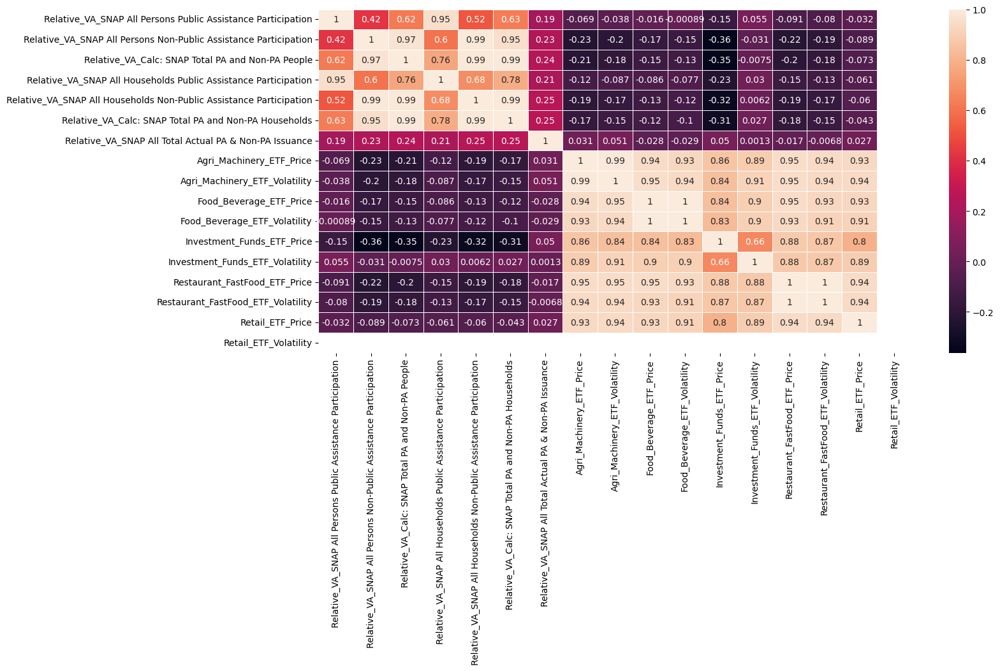

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


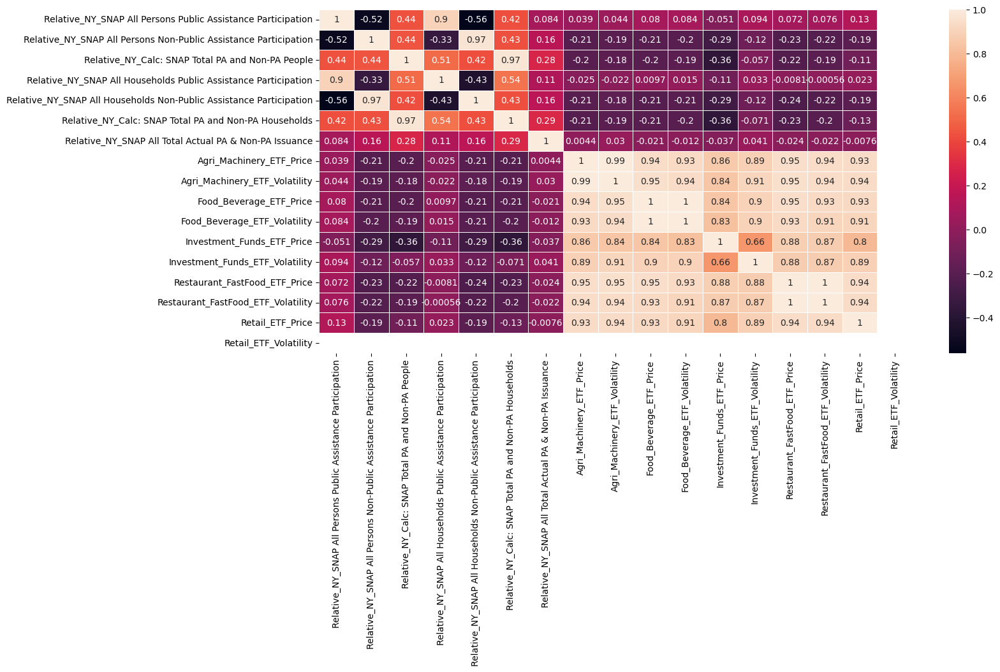

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


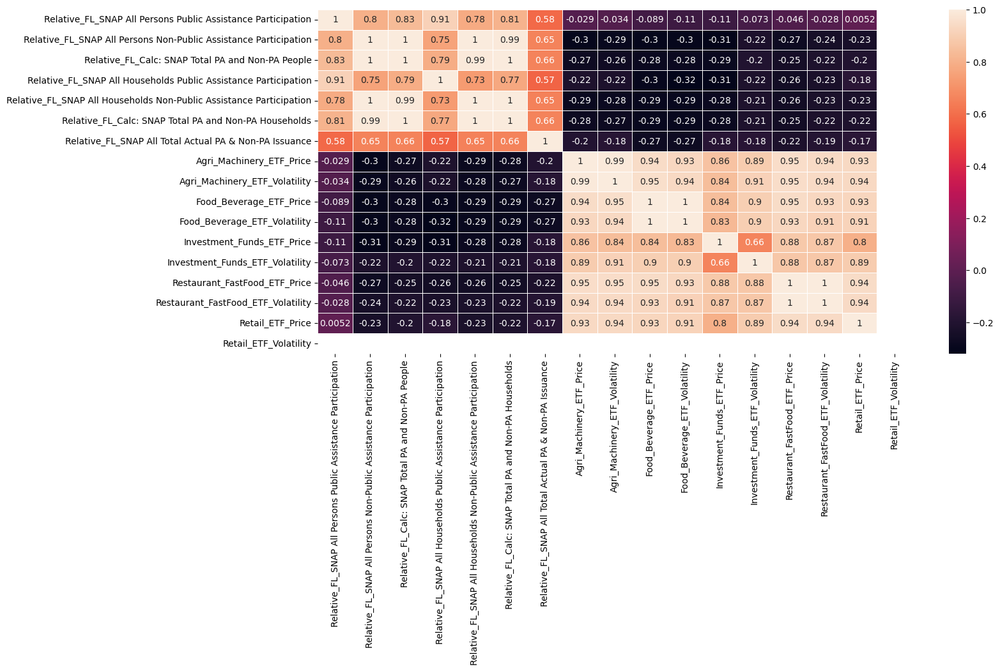

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


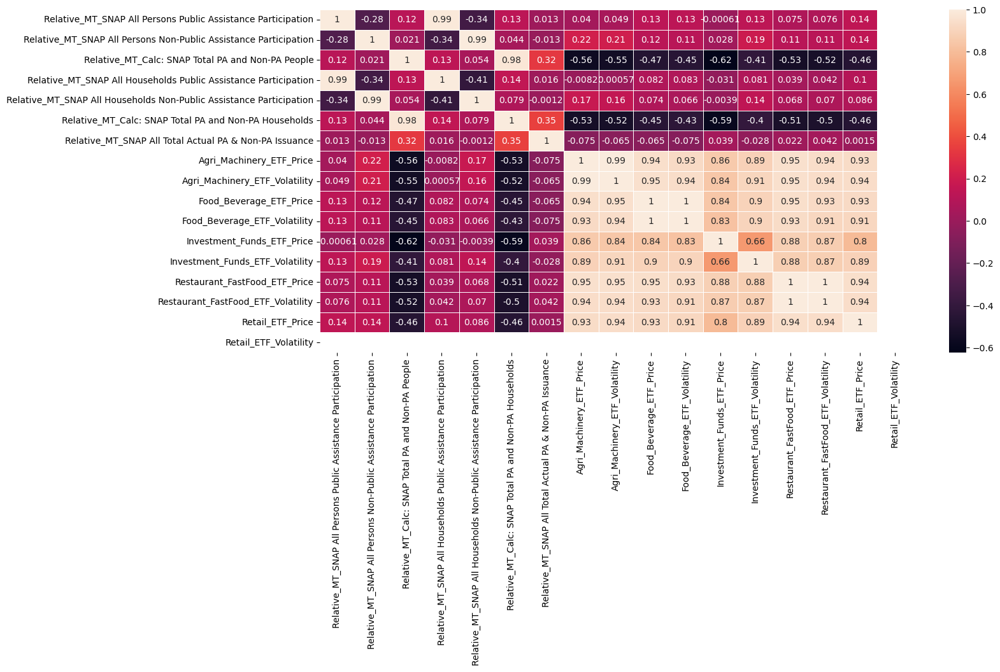

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


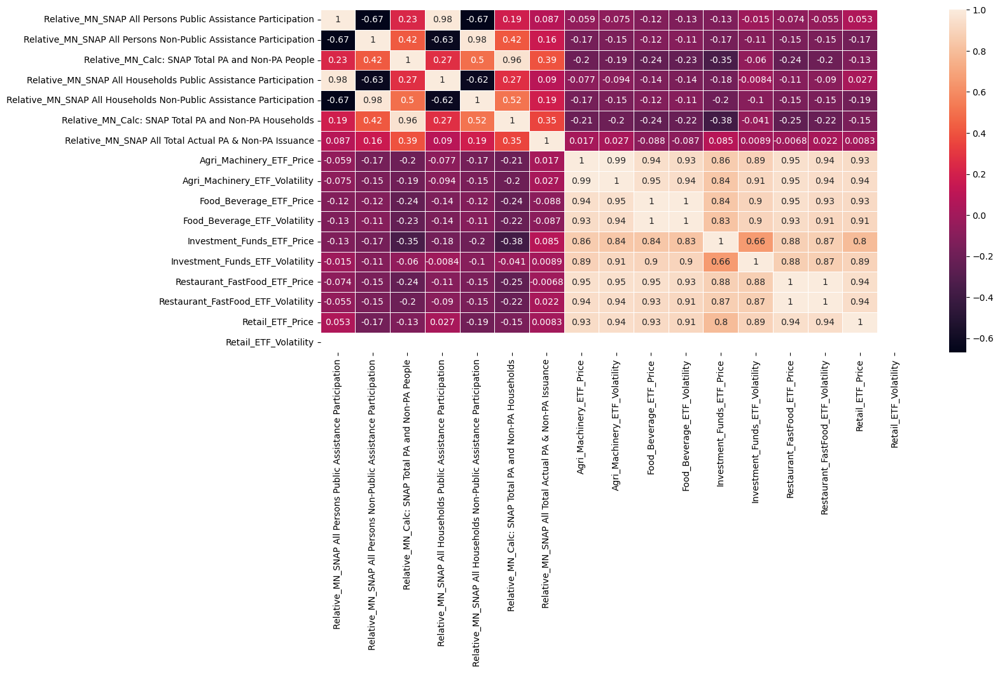

/var/folders/_x/3gwpfcn92dncqz0cw4kmf48m0000gn/T/ipykernel_81184/4043290551.py:20: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  adjusted_state_snap_data['Relative_' + column] = tempVal


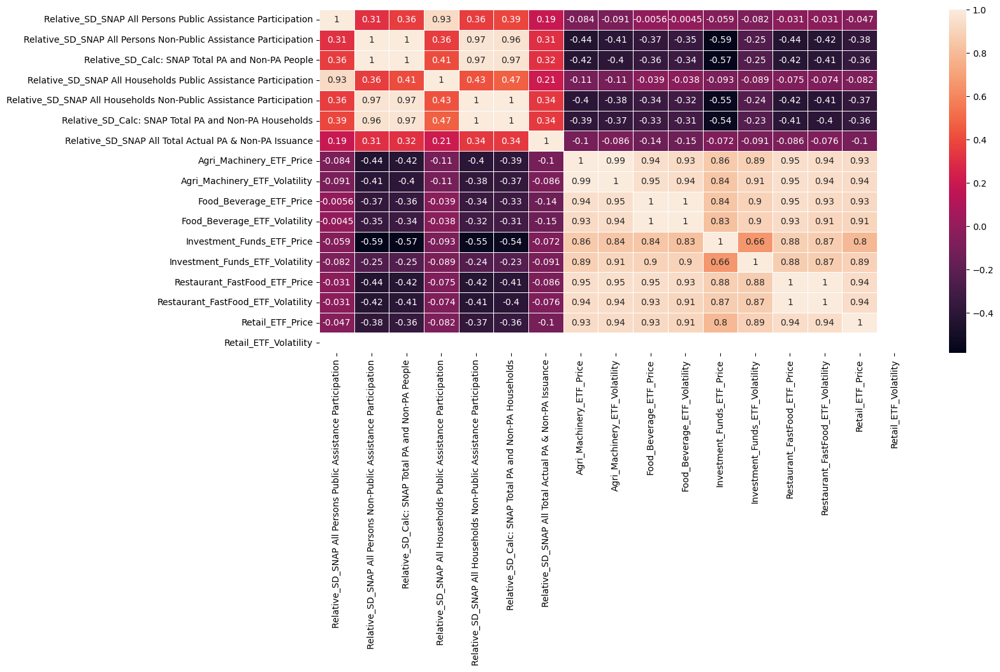

In [ ]:
states = snap_data.columns[2:].str.split("_")
states = set([state[0] for state in states])

for state in states:
    state_snap_data = snap_data
    for column in state_snap_data.columns:
        if state not in column:
            state_snap_data = state_snap_data.drop(column, axis = 1) 
    
    state_snap_data['Year'] = snap_data['Year']
    state_snap_data['Month'] = snap_data['Month']

    relative_snap_data = pd.DataFrame() 

    relativeCols = state_snap_data.columns.unique()[:-2]
    adjusted_state_snap_data = state_snap_data.iloc[1:, :]
    for column in relativeCols:
        shiftedForward = state_snap_data[column][1:]
        tempVal = (np.array(shiftedForward) - np.array(state_snap_data[column][:-1])) / np.array(np.array(state_snap_data[column][:-1])) * 100
        adjusted_state_snap_data['Relative_' + column] = tempVal
        adjusted_state_snap_data = adjusted_state_snap_data.drop(column, axis = 1)

    
    finalDF3 = pd.merge(
        left=adjusted_state_snap_data, 
        right=transformed_etf_data,
        how='left',
        left_on=['Year', 'Month'],
        right_on=['Year', 'Month'])
    
    finalDF3 = finalDF3.dropna()
    
    corr_matrix = finalDF3.drop(columns=['Year', 'Month']).corr()
    
    plt.figure(figsize=(15, 7))
    sns.heatmap(corr_matrix, annot=True, cmap='rocket', linewidths=0.5)
    plt.show()